In [1]:
%matplotlib inline
# import tensorflow_addons as tfa
from os import listdir, makedirs
from os.path import isfile, join, basename, splitext, isfile, exists
import tensorflow 
from tensorflow.keras.metrics import top_k_categorical_accuracy, CategoricalHinge, Recall, Precision
import numpy as np
import pandas as pd
from sklearn.utils import shuffle
# from tqdm import tqdm_notebook

import tensorflow as tf
import tensorflow.keras.backend as K
# from tensorflow.keras import metrics

import tensorflow.keras
from tensorflow.compat.v2.keras.layers import Input

import matplotlib.pyplot as plt
# import seaborn as sns

import random, os, sys
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.callbacks import *
from tensorflow.keras.initializers import *
import tensorflow as tf
from tensorflow.python.keras.layers import Layer
import h5py
import os

tf.compat.v1.disable_eager_execution
pd.set_option('display.precision', 30)
np.set_printoptions(precision = 30)
tf.config.list_physical_devices('GPU')  
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
#np.random.seed(368)
#tf.random.set_seed(368)

Num GPUs Available:  1


In [2]:
xfileName='xau_usd_3.0Tp3.0Cl100Vp-zipzag10_20_100.txt'
# xfileName='xau_usd_3.0Tp3.0Cl100Vp-test.txt'
xfile='C:\\workspace\\j6stock\\' + xfileName

# seq_len = 60 * 4 #60*10 # 3 days + 2 features is enough memory
seq_len = 60 #60*10 # 3 days + 2 features is enough memory

# batch_size = int(2048/2/2)       # Batch size
batch_size = 10
# mini_batch_size = 64       # Batch size

learning_rate = 0.005  #0.0001  # Learning rate (default is 0.001)
epochs = 500


y_column = 6
compute_val_at = 0
acc_filtered_r = 0.8


upperTailFilter = 0.4
lowerTailFilter = 0.4

import tensorflow as tf
from tensorflow.python import debug as tf_debug
from sklearn import preprocessing
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt2
import pandas as pd
from pandas import datetime
import math, time
import itertools
from sklearn import preprocessing
import datetime
from sklearn.metrics import mean_squared_error
from math import sqrt
#from keras.models import Sequential
#from keras.layers.core import Dense, Dropout, Activation
#from keras.layers.recurrent import LSTM
#from keras.models import load_model
#import keras
import pandas as pd ## can be remove once pandas_datareader 0.7 using
pd.core.common.is_list_like = pd.api.types.is_list_like ## can be remove once pandas_datareader 0.7 using
import pandas_datareader.data as web



def get_stock_data(normalize=True, ma=[]):
    """
    Return a dataframe of that stock and normalize all the values. 
    (Optional: create moving average)
    """
    global upperTailFilter, lowerTailFilter
    
    df = pd.read_csv(filepath_or_buffer  = xfile )

    return df

df = get_stock_data()

# amount_of_features = len(df.columns)-1+(input2Length*-1)

# def load_data(stock, seq_len):
#     print ("Amount of features = {}".format(amount_of_features))
#     data = stock.as_matrix()
#     sequence_length = seq_len + 1 # index starting from 0
#     x_result = []
#     x_result2 = []
#     y_result = []
#     for index in range(seq_len, len(data) ): # maxmimum date = lastest date - sequence length
#         x_result.append(data[index-seq_len: index,
#                              :-1 + (input2Length*-1) # -2 is ignore Input2 features
#                             ]) # index : index + 22days
#         x_result2.append(data[index, -1 + (input2Length*-1):-1])
#         y_result.append(data[index ,-1]);

#     x_result, x_result2, y_result = shuffle(x_result, x_result2, y_result , random_state=2)

#     #print('---', data[0])
#     #print('---', x_result[0])
#     #print('---', y_result[0])
#     x_result = np.array(x_result)
#     x_result2 = np.array(x_result2)
#     y_result = np.array(y_result)
#     print ("Amount of data = {}".format(y_result.shape[0]))

#     percentageSplit = 0.5 # 60% split
#     row = round(percentageSplit * y_result.shape[0]) 
#     print ("Split = {}".format(row))
 
#     X_train = x_result[:int(row), :] 
#     X_train2 = x_result2[:int(row), :] 
#     y_train = y_result[:int(row)] 
#     print ("Amount of training data = {}".format(y_train.shape[0]))
#     X_test = x_result[int(row):, :]
#     X_test2 = x_result2[int(row):, :]
#     y_test = y_result[int(row):]
#     # filter for 1 and -1 for validation only
#     X_test = X_test[y_test[:]!=0,:]
#     X_test2 = X_test2[y_test[:]!=0,:]
#     y_test = y_test[y_test[:]!=0]
    
#     # split 50% again for test and validation set
#     row = round(percentageSplit * y_test.shape[0]) 
#     X_val = X_test[int(row):, :]
#     X_val2 = X_test2[int(row):, :]
#     y_val = y_test[int(row):]
#     print ("Amount of validation data = {}".format(y_val.shape[0]))
#     X_test = X_test[:int(row), :]
#     X_test2 = X_test2[:int(row), :]
#     y_test = y_test[:int(row)]
#     print ("Amount of testing data = {}".format(y_test.shape[0]))
#     #print(result.shape[0], len(y_result), int(row), y_result[int(row):])
#     #X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], amount_of_features-1))
#     #X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], amount_of_features-1))    
#     return [X_train, X_train2, y_train, X_test, X_test2, y_test, X_val, X_val2, y_val]


 

df_to_dataset = df[['close']].copy()
# df_to_dataset = df[[  'zipzag10' ]].copy()

# print(df_to_dataset.zipzag.str.len().min())
# df_to_dataset_input2 = df[[ 'tail_upper', 'tail_lower', 'change' ,'cross_360p_high', 'cross_1440p_high', 'hour'
#                           ]].copy()
df_to_dataset_input2 = df[[ 'tail_upper', 'tail_lower', 'change' , 'hour'
                          ]].copy()

amount_of_features = len(df_to_dataset.columns)
 
input2Length = len(df_to_dataset_input2.columns)

# df.drop(labels=['close'], axis=1, inplace=True)
# df.drop(labels=['tail_upper'], axis=1, inplace=True)
# df.drop(labels=['tail_lower'], axis=1, inplace=True)
# df.drop(labels=['cross_360p_high'], axis=1, inplace=True)
# df.drop(labels=['cross_1440p_high'], axis=1, inplace=True)


df_to_dataset_y = tf.keras.utils.to_categorical(df[['y_result']].copy())
df.drop(labels=['y_result'], axis=1, inplace=True)

# train_data_no = int(len(df_to_dataset_y)/2)
# test_data_no = int(train_data_no/2)
# v_data_no = test_data_no

train_data_no = int(len(df_to_dataset_y)/2)
test_data_no = int(len(df_to_dataset_y)/2/2)
v_data_no = test_data_no

train_x_1 = df_to_dataset.iloc[:train_data_no].values
train_x_2 = df_to_dataset_input2.iloc[:train_data_no].values
train_y = df_to_dataset_y[:train_data_no]                                                   

test_x_1 = df_to_dataset.iloc[train_data_no:train_data_no+test_data_no].values
test_x_2 = df_to_dataset_input2.iloc[train_data_no:train_data_no+test_data_no].values
test_y = df_to_dataset_y[train_data_no:train_data_no+test_data_no]                                                   

v_x_1 = df_to_dataset.iloc[train_data_no+test_data_no:-500].values
v_x_2 = df_to_dataset_input2.iloc[train_data_no+test_data_no:-500].values
v_y = df_to_dataset_y[train_data_no+test_data_no:-500]                                                   
 
def make_window_dataset(ds, window_size=1, shift=1, stride=1):
#   windows = ds.window(window_size, shift=shift, stride=stride)
  windows = ds 
  def strTensor(str): 
    string_vals=tf.strings.split(str,';') 
    string_vals = tf.strings.to_number(string_vals, tf.float32)
    return  tf.RaggedTensor.to_tensor(string_vals) 
  # Define a function to zip the values
  def zip_values(a):
    if amount_of_features > 1 :
      return tf.stack([a[0]], axis=1)

    return a[0]
    
#   windows = windows.map(lambda sub1, sub2: (( tf.ragged.map_flat_values(zip_values, strTensor(sub1[0])), sub1[1]), sub2))
  windows = windows.map(lambda sub1, sub2: (( tf.ragged.map_flat_values(zip_values, strTensor(sub1[0])), sub1[1]), sub2))

  return windows
 

def filter_fn(a, b):
#   return a[1][0]>=upperTailFilter or a[1][1]>=lowerTailFilter or a[1][3]==1 or a[1][4]==1
  return a[1][0]==1

train_dataset_x = tf.data.Dataset.from_tensor_slices(((train_x_1, train_x_2),(train_y)))
train_dataset = make_window_dataset(train_dataset_x).filter(filter_fn).shuffle(buffer_size=train_data_no).cache().batch(batch_size, drop_remainder=True) 

test_dataset_x = tf.data.Dataset.from_tensor_slices(((test_x_1, test_x_2),(test_y)))
test_dataset = make_window_dataset(test_dataset_x).filter(filter_fn).shuffle(buffer_size=test_data_no).cache().batch(batch_size, drop_remainder=True)

v_dataset_x = tf.data.Dataset.from_tensor_slices(((v_x_1, v_x_2),(v_y)))
v_dataset = make_window_dataset(v_dataset_x).filter(filter_fn).shuffle(buffer_size=v_data_no).cache().batch(batch_size, drop_remainder=True)



In [3]:
classes = [0,1] # 1 long, 0 short 
print( tf.keras.utils.to_categorical(classes)) 
for element in v_x_1:
  print(element)

[[1. 0.]
 [0. 1.]]
['0.69772;0.69812;0.69863;0.69896;0.69896;0.69902;0.69904;0.69899;0.69903;0.69884;0.69913;0.69898;0.69913;0.69933;0.69926;0.69918;0.69914;0.69913;0.69900;0.69883;0.69863;0.69871;0.69855;0.69880;0.69915;0.69947;0.69938;0.69905;0.69926;0.69930']
['0.69812;0.69863;0.69896;0.69896;0.69902;0.69904;0.69899;0.69903;0.69884;0.69913;0.69898;0.69913;0.69933;0.69926;0.69918;0.69914;0.69913;0.69900;0.69883;0.69863;0.69871;0.69855;0.69880;0.69915;0.69947;0.69938;0.69905;0.69926;0.69930;0.69938']
['0.69863;0.69896;0.69896;0.69902;0.69904;0.69899;0.69903;0.69884;0.69913;0.69898;0.69913;0.69933;0.69926;0.69918;0.69914;0.69913;0.69900;0.69883;0.69863;0.69871;0.69855;0.69880;0.69915;0.69947;0.69938;0.69905;0.69926;0.69930;0.69938;0.69904']
['0.69896;0.69896;0.69902;0.69904;0.69899;0.69903;0.69884;0.69913;0.69898;0.69913;0.69933;0.69926;0.69918;0.69914;0.69913;0.69900;0.69883;0.69863;0.69871;0.69855;0.69880;0.69915;0.69947;0.69938;0.69905;0.69926;0.69930;0.69938;0.69904;0.69888']
['0.6

['0.71283;0.71270;0.71275;0.71248;0.71225;0.71253;0.71222;0.71184;0.71179;0.71158;0.71149;0.71144;0.71169;0.71148;0.71178;0.71197;0.71211;0.71196;0.71229;0.71207;0.71245;0.71231;0.71231;0.71209;0.71218;0.71223;0.71254;0.71269;0.71262;0.71263']
['0.71270;0.71275;0.71248;0.71225;0.71253;0.71222;0.71184;0.71179;0.71158;0.71149;0.71144;0.71169;0.71148;0.71178;0.71197;0.71211;0.71196;0.71229;0.71207;0.71245;0.71231;0.71231;0.71209;0.71218;0.71223;0.71254;0.71269;0.71262;0.71263;0.71300']
['0.71275;0.71248;0.71225;0.71253;0.71222;0.71184;0.71179;0.71158;0.71149;0.71144;0.71169;0.71148;0.71178;0.71197;0.71211;0.71196;0.71229;0.71207;0.71245;0.71231;0.71231;0.71209;0.71218;0.71223;0.71254;0.71269;0.71262;0.71263;0.71300;0.71316']
['0.71248;0.71225;0.71253;0.71222;0.71184;0.71179;0.71158;0.71149;0.71144;0.71169;0.71148;0.71178;0.71197;0.71211;0.71196;0.71229;0.71207;0.71245;0.71231;0.71231;0.71209;0.71218;0.71223;0.71254;0.71269;0.71262;0.71263;0.71300;0.71316;0.71335']
['0.71225;0.71253;0.7122

['0.69849;0.69816;0.69788;0.69730;0.69772;0.69790;0.69844;0.69832;0.69824;0.69884;0.69900;0.69911;0.69891;0.69885;0.69875;0.69912;0.69878;0.69908;0.69884;0.69884;0.69919;0.69872;0.69853;0.69865;0.69895;0.69943;0.69904;0.69888;0.69860;0.69861']
['0.69816;0.69788;0.69730;0.69772;0.69790;0.69844;0.69832;0.69824;0.69884;0.69900;0.69911;0.69891;0.69885;0.69875;0.69912;0.69878;0.69908;0.69884;0.69884;0.69919;0.69872;0.69853;0.69865;0.69895;0.69943;0.69904;0.69888;0.69860;0.69861;0.69863']
['0.69788;0.69730;0.69772;0.69790;0.69844;0.69832;0.69824;0.69884;0.69900;0.69911;0.69891;0.69885;0.69875;0.69912;0.69878;0.69908;0.69884;0.69884;0.69919;0.69872;0.69853;0.69865;0.69895;0.69943;0.69904;0.69888;0.69860;0.69861;0.69863;0.69909']
['0.69730;0.69772;0.69790;0.69844;0.69832;0.69824;0.69884;0.69900;0.69911;0.69891;0.69885;0.69875;0.69912;0.69878;0.69908;0.69884;0.69884;0.69919;0.69872;0.69853;0.69865;0.69895;0.69943;0.69904;0.69888;0.69860;0.69861;0.69863;0.69909;0.69857']
['0.69772;0.69790;0.6984

['0.72788;0.72780;0.72784;0.72744;0.72776;0.72778;0.72842;0.72838;0.72865;0.72902;0.72932;0.72929;0.72891;0.72883;0.72899;0.72887;0.72803;0.72847;0.72835;0.72921;0.72913;0.72858;0.72872;0.72908;0.72863;0.72832;0.72809;0.72801;0.72890;0.72894']
['0.72780;0.72784;0.72744;0.72776;0.72778;0.72842;0.72838;0.72865;0.72902;0.72932;0.72929;0.72891;0.72883;0.72899;0.72887;0.72803;0.72847;0.72835;0.72921;0.72913;0.72858;0.72872;0.72908;0.72863;0.72832;0.72809;0.72801;0.72890;0.72894;0.72925']
['0.72784;0.72744;0.72776;0.72778;0.72842;0.72838;0.72865;0.72902;0.72932;0.72929;0.72891;0.72883;0.72899;0.72887;0.72803;0.72847;0.72835;0.72921;0.72913;0.72858;0.72872;0.72908;0.72863;0.72832;0.72809;0.72801;0.72890;0.72894;0.72925;0.72996']
['0.72744;0.72776;0.72778;0.72842;0.72838;0.72865;0.72902;0.72932;0.72929;0.72891;0.72883;0.72899;0.72887;0.72803;0.72847;0.72835;0.72921;0.72913;0.72858;0.72872;0.72908;0.72863;0.72832;0.72809;0.72801;0.72890;0.72894;0.72925;0.72996;0.72999']
['0.72776;0.72778;0.7284

['0.73018;0.73005;0.72976;0.73030;0.73004;0.73010;0.73005;0.73013;0.73013;0.73031;0.73062;0.73080;0.73068;0.73032;0.73023;0.73025;0.73046;0.73056;0.73055;0.73048;0.73063;0.73073;0.73078;0.73060;0.73080;0.73082;0.73117;0.73133;0.73123;0.73125']
['0.73005;0.72976;0.73030;0.73004;0.73010;0.73005;0.73013;0.73013;0.73031;0.73062;0.73080;0.73068;0.73032;0.73023;0.73025;0.73046;0.73056;0.73055;0.73048;0.73063;0.73073;0.73078;0.73060;0.73080;0.73082;0.73117;0.73133;0.73123;0.73125;0.73128']
['0.72976;0.73030;0.73004;0.73010;0.73005;0.73013;0.73013;0.73031;0.73062;0.73080;0.73068;0.73032;0.73023;0.73025;0.73046;0.73056;0.73055;0.73048;0.73063;0.73073;0.73078;0.73060;0.73080;0.73082;0.73117;0.73133;0.73123;0.73125;0.73128;0.73127']
['0.73030;0.73004;0.73010;0.73005;0.73013;0.73013;0.73031;0.73062;0.73080;0.73068;0.73032;0.73023;0.73025;0.73046;0.73056;0.73055;0.73048;0.73063;0.73073;0.73078;0.73060;0.73080;0.73082;0.73117;0.73133;0.73123;0.73125;0.73128;0.73127;0.73118']
['0.73004;0.73010;0.7300

['0.73514;0.73496;0.73512;0.73492;0.73469;0.73488;0.73538;0.73574;0.73530;0.73495;0.73501;0.73473;0.73487;0.73471;0.73526;0.73505;0.73518;0.73527;0.73525;0.73511;0.73477;0.73531;0.73535;0.73518;0.73528;0.73523;0.73586;0.73547;0.73517;0.73523']
['0.73496;0.73512;0.73492;0.73469;0.73488;0.73538;0.73574;0.73530;0.73495;0.73501;0.73473;0.73487;0.73471;0.73526;0.73505;0.73518;0.73527;0.73525;0.73511;0.73477;0.73531;0.73535;0.73518;0.73528;0.73523;0.73586;0.73547;0.73517;0.73523;0.73523']
['0.73512;0.73492;0.73469;0.73488;0.73538;0.73574;0.73530;0.73495;0.73501;0.73473;0.73487;0.73471;0.73526;0.73505;0.73518;0.73527;0.73525;0.73511;0.73477;0.73531;0.73535;0.73518;0.73528;0.73523;0.73586;0.73547;0.73517;0.73523;0.73523;0.73508']
['0.73492;0.73469;0.73488;0.73538;0.73574;0.73530;0.73495;0.73501;0.73473;0.73487;0.73471;0.73526;0.73505;0.73518;0.73527;0.73525;0.73511;0.73477;0.73531;0.73535;0.73518;0.73528;0.73523;0.73586;0.73547;0.73517;0.73523;0.73523;0.73508;0.73509']
['0.73469;0.73488;0.7353

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['0.72165;0.72174;0.72163;0.72202;0.72215;0.72198;0.72263;0.72309;0.72284;0.72303;0.72325;0.72347;0.72353;0.72308;0.72292;0.72253;0.72285;0.72253;0.72247;0.72269;0.72229;0.72213;0.72201;0.72197;0.72231;0.72226;0.72289;0.72279;0.72263;0.72254']
['0.72174;0.72163;0.72202;0.72215;0.72198;0.72263;0.72309;0.72284;0.72303;0.72325;0.72347;0.72353;0.72308;0.72292;0.72253;0.72285;0.72253;0.72247;0.72269;0.72229;0.72213;0.72201;0.72197;0.72231;0.72226;0.72289;0.72279;0.72263;0.72254;0.72275']
['0.72163;0.72202;0.72215;0.72198;0.72263;0.72309;0.72284;0.72303;0.72325;0.72347;0.72353;0.72308;0.72292;0.72253;0.72285;0.72253;0.72247;0.72269;0.72229;0.72213;0.72201;0.72197;0.72231;0.72226;0.72289;0.72279;0.72263;0.72254;0.72275;0.72282']
['0.72202;0.72215;0.72198;0.72263;0.72309;0.72284;0.72303;0.72325;0.72347;0.72353;0.72308;0.72292;0.72253;0.72285;0.72253;0.72247;0.72269;0.72229;0.72213;0.72201;0.72197;0.72231;0.72226;0.72289;0.72279;0.72263;0.72254;0.72275;0.72282;0.72288']
['0.72215;0.72198;0.722

['0.72997;0.73001;0.72988;0.72988;0.72996;0.73029;0.73025;0.73029;0.73065;0.73121;0.73080;0.73065;0.73055;0.73072;0.73046;0.73025;0.73002;0.73028;0.73018;0.73023;0.73055;0.73034;0.73040;0.73030;0.73029;0.73038;0.73075;0.73063;0.73080;0.73096']
['0.73001;0.72988;0.72988;0.72996;0.73029;0.73025;0.73029;0.73065;0.73121;0.73080;0.73065;0.73055;0.73072;0.73046;0.73025;0.73002;0.73028;0.73018;0.73023;0.73055;0.73034;0.73040;0.73030;0.73029;0.73038;0.73075;0.73063;0.73080;0.73096;0.73096']
['0.72988;0.72988;0.72996;0.73029;0.73025;0.73029;0.73065;0.73121;0.73080;0.73065;0.73055;0.73072;0.73046;0.73025;0.73002;0.73028;0.73018;0.73023;0.73055;0.73034;0.73040;0.73030;0.73029;0.73038;0.73075;0.73063;0.73080;0.73096;0.73096;0.73105']
['0.72988;0.72996;0.73029;0.73025;0.73029;0.73065;0.73121;0.73080;0.73065;0.73055;0.73072;0.73046;0.73025;0.73002;0.73028;0.73018;0.73023;0.73055;0.73034;0.73040;0.73030;0.73029;0.73038;0.73075;0.73063;0.73080;0.73096;0.73096;0.73105;0.73088']
['0.72996;0.73029;0.7302

['0.73475;0.73465;0.73477;0.73484;0.73501;0.73579;0.73587;0.73561;0.73539;0.73518;0.73497;0.73498;0.73478;0.73485;0.73499;0.73500;0.73473;0.73470;0.73414;0.73473;0.73465;0.73493;0.73508;0.73520;0.73541;0.73503;0.73460;0.73453;0.73438;0.73448']
['0.73465;0.73477;0.73484;0.73501;0.73579;0.73587;0.73561;0.73539;0.73518;0.73497;0.73498;0.73478;0.73485;0.73499;0.73500;0.73473;0.73470;0.73414;0.73473;0.73465;0.73493;0.73508;0.73520;0.73541;0.73503;0.73460;0.73453;0.73438;0.73448;0.73456']
['0.73477;0.73484;0.73501;0.73579;0.73587;0.73561;0.73539;0.73518;0.73497;0.73498;0.73478;0.73485;0.73499;0.73500;0.73473;0.73470;0.73414;0.73473;0.73465;0.73493;0.73508;0.73520;0.73541;0.73503;0.73460;0.73453;0.73438;0.73448;0.73456;0.73493']
['0.73484;0.73501;0.73579;0.73587;0.73561;0.73539;0.73518;0.73497;0.73498;0.73478;0.73485;0.73499;0.73500;0.73473;0.73470;0.73414;0.73473;0.73465;0.73493;0.73508;0.73520;0.73541;0.73503;0.73460;0.73453;0.73438;0.73448;0.73456;0.73493;0.73520']
['0.73501;0.73579;0.7358

['0.71855;0.71888;0.71854;0.71843;0.71831;0.71830;0.71815;0.71803;0.71803;0.71812;0.71798;0.71801;0.71784;0.71788;0.71800;0.71842;0.71839;0.71837;0.71833;0.71829;0.71884;0.71886;0.71843;0.71857;0.71877;0.71869;0.71876;0.71882;0.71929;0.71933']
['0.71888;0.71854;0.71843;0.71831;0.71830;0.71815;0.71803;0.71803;0.71812;0.71798;0.71801;0.71784;0.71788;0.71800;0.71842;0.71839;0.71837;0.71833;0.71829;0.71884;0.71886;0.71843;0.71857;0.71877;0.71869;0.71876;0.71882;0.71929;0.71933;0.71981']
['0.71854;0.71843;0.71831;0.71830;0.71815;0.71803;0.71803;0.71812;0.71798;0.71801;0.71784;0.71788;0.71800;0.71842;0.71839;0.71837;0.71833;0.71829;0.71884;0.71886;0.71843;0.71857;0.71877;0.71869;0.71876;0.71882;0.71929;0.71933;0.71981;0.71960']
['0.71843;0.71831;0.71830;0.71815;0.71803;0.71803;0.71812;0.71798;0.71801;0.71784;0.71788;0.71800;0.71842;0.71839;0.71837;0.71833;0.71829;0.71884;0.71886;0.71843;0.71857;0.71877;0.71869;0.71876;0.71882;0.71929;0.71933;0.71981;0.71960;0.71978']
['0.71831;0.71830;0.7181

['0.71403;0.71378;0.71374;0.71386;0.71408;0.71403;0.71419;0.71419;0.71401;0.71414;0.71401;0.71434;0.71428;0.71426;0.71439;0.71413;0.71433;0.71452;0.71468;0.71462;0.71488;0.71509;0.71504;0.71521;0.71508;0.71476;0.71458;0.71480;0.71493;0.71516']
['0.71378;0.71374;0.71386;0.71408;0.71403;0.71419;0.71419;0.71401;0.71414;0.71401;0.71434;0.71428;0.71426;0.71439;0.71413;0.71433;0.71452;0.71468;0.71462;0.71488;0.71509;0.71504;0.71521;0.71508;0.71476;0.71458;0.71480;0.71493;0.71516;0.71515']
['0.71374;0.71386;0.71408;0.71403;0.71419;0.71419;0.71401;0.71414;0.71401;0.71434;0.71428;0.71426;0.71439;0.71413;0.71433;0.71452;0.71468;0.71462;0.71488;0.71509;0.71504;0.71521;0.71508;0.71476;0.71458;0.71480;0.71493;0.71516;0.71515;0.71493']
['0.71386;0.71408;0.71403;0.71419;0.71419;0.71401;0.71414;0.71401;0.71434;0.71428;0.71426;0.71439;0.71413;0.71433;0.71452;0.71468;0.71462;0.71488;0.71509;0.71504;0.71521;0.71508;0.71476;0.71458;0.71480;0.71493;0.71516;0.71515;0.71493;0.71473']
['0.71408;0.71403;0.7141

['0.69755;0.69718;0.69691;0.69636;0.69696;0.69664;0.69673;0.69674;0.69659;0.69673;0.69648;0.69592;0.69610;0.69617;0.69649;0.69623;0.69643;0.69679;0.69673;0.69653;0.69656;0.69660;0.69667;0.69667;0.69649;0.69723;0.69728;0.69702;0.69674;0.69681']
['0.69718;0.69691;0.69636;0.69696;0.69664;0.69673;0.69674;0.69659;0.69673;0.69648;0.69592;0.69610;0.69617;0.69649;0.69623;0.69643;0.69679;0.69673;0.69653;0.69656;0.69660;0.69667;0.69667;0.69649;0.69723;0.69728;0.69702;0.69674;0.69681;0.69640']
['0.69691;0.69636;0.69696;0.69664;0.69673;0.69674;0.69659;0.69673;0.69648;0.69592;0.69610;0.69617;0.69649;0.69623;0.69643;0.69679;0.69673;0.69653;0.69656;0.69660;0.69667;0.69667;0.69649;0.69723;0.69728;0.69702;0.69674;0.69681;0.69640;0.69643']
['0.69636;0.69696;0.69664;0.69673;0.69674;0.69659;0.69673;0.69648;0.69592;0.69610;0.69617;0.69649;0.69623;0.69643;0.69679;0.69673;0.69653;0.69656;0.69660;0.69667;0.69667;0.69649;0.69723;0.69728;0.69702;0.69674;0.69681;0.69640;0.69643;0.69618']
['0.69696;0.69664;0.6967

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['0.71870;0.71951;0.71883;0.71896;0.71943;0.71941;0.71977;0.71968;0.71948;0.71964;0.71963;0.71980;0.71984;0.71986;0.71969;0.72000;0.72014;0.72046;0.72054;0.72081;0.72094;0.72133;0.72103;0.72099;0.72090;0.72087;0.72101;0.72084;0.72129;0.72090']
['0.71951;0.71883;0.71896;0.71943;0.71941;0.71977;0.71968;0.71948;0.71964;0.71963;0.71980;0.71984;0.71986;0.71969;0.72000;0.72014;0.72046;0.72054;0.72081;0.72094;0.72133;0.72103;0.72099;0.72090;0.72087;0.72101;0.72084;0.72129;0.72090;0.72082']
['0.71883;0.71896;0.71943;0.71941;0.71977;0.71968;0.71948;0.71964;0.71963;0.71980;0.71984;0.71986;0.71969;0.72000;0.72014;0.72046;0.72054;0.72081;0.72094;0.72133;0.72103;0.72099;0.72090;0.72087;0.72101;0.72084;0.72129;0.72090;0.72082;0.72078']
['0.71896;0.71943;0.71941;0.71977;0.71968;0.71948;0.71964;0.71963;0.71980;0.71984;0.71986;0.71969;0.72000;0.72014;0.72046;0.72054;0.72081;0.72094;0.72133;0.72103;0.72099;0.72090;0.72087;0.72101;0.72084;0.72129;0.72090;0.72082;0.72078;0.72090']
['0.71943;0.71941;0.7197

['0.75401;0.75373;0.75390;0.75401;0.75420;0.75436;0.75383;0.75360;0.75328;0.75374;0.75386;0.75388;0.75403;0.75409;0.75448;0.75412;0.75409;0.75458;0.75487;0.75542;0.75534;0.75516;0.75507;0.75524;0.75518;0.75526;0.75530;0.75553;0.75560;0.75562']
['0.75373;0.75390;0.75401;0.75420;0.75436;0.75383;0.75360;0.75328;0.75374;0.75386;0.75388;0.75403;0.75409;0.75448;0.75412;0.75409;0.75458;0.75487;0.75542;0.75534;0.75516;0.75507;0.75524;0.75518;0.75526;0.75530;0.75553;0.75560;0.75562;0.75548']
['0.75390;0.75401;0.75420;0.75436;0.75383;0.75360;0.75328;0.75374;0.75386;0.75388;0.75403;0.75409;0.75448;0.75412;0.75409;0.75458;0.75487;0.75542;0.75534;0.75516;0.75507;0.75524;0.75518;0.75526;0.75530;0.75553;0.75560;0.75562;0.75548;0.75519']
['0.75401;0.75420;0.75436;0.75383;0.75360;0.75328;0.75374;0.75386;0.75388;0.75403;0.75409;0.75448;0.75412;0.75409;0.75458;0.75487;0.75542;0.75534;0.75516;0.75507;0.75524;0.75518;0.75526;0.75530;0.75553;0.75560;0.75562;0.75548;0.75519;0.75499']
['0.75420;0.75436;0.7538

['0.74734;0.74647;0.74536;0.74430;0.74379;0.74503;0.74516;0.74598;0.74582;0.74690;0.74662;0.74619;0.74727;0.74751;0.74772;0.74683;0.74783;0.74800;0.74853;0.74898;0.75087;0.75263;0.75293;0.75217;0.75159;0.75292;0.75347;0.75517;0.75511;0.75404']
['0.74647;0.74536;0.74430;0.74379;0.74503;0.74516;0.74598;0.74582;0.74690;0.74662;0.74619;0.74727;0.74751;0.74772;0.74683;0.74783;0.74800;0.74853;0.74898;0.75087;0.75263;0.75293;0.75217;0.75159;0.75292;0.75347;0.75517;0.75511;0.75404;0.75429']
['0.74536;0.74430;0.74379;0.74503;0.74516;0.74598;0.74582;0.74690;0.74662;0.74619;0.74727;0.74751;0.74772;0.74683;0.74783;0.74800;0.74853;0.74898;0.75087;0.75263;0.75293;0.75217;0.75159;0.75292;0.75347;0.75517;0.75511;0.75404;0.75429;0.75363']
['0.74430;0.74379;0.74503;0.74516;0.74598;0.74582;0.74690;0.74662;0.74619;0.74727;0.74751;0.74772;0.74683;0.74783;0.74800;0.74853;0.74898;0.75087;0.75263;0.75293;0.75217;0.75159;0.75292;0.75347;0.75517;0.75511;0.75404;0.75429;0.75363;0.75293']
['0.74379;0.74503;0.7451

['0.76443;0.76417;0.76435;0.76354;0.76331;0.76307;0.76323;0.76318;0.76302;0.76338;0.76340;0.76305;0.76237;0.76227;0.76250;0.76260;0.76351;0.76494;0.76578;0.76603;0.76597;0.76502;0.76513;0.76512;0.76465;0.76344;0.76420;0.76438;0.76456;0.76484']
['0.76417;0.76435;0.76354;0.76331;0.76307;0.76323;0.76318;0.76302;0.76338;0.76340;0.76305;0.76237;0.76227;0.76250;0.76260;0.76351;0.76494;0.76578;0.76603;0.76597;0.76502;0.76513;0.76512;0.76465;0.76344;0.76420;0.76438;0.76456;0.76484;0.76498']
['0.76435;0.76354;0.76331;0.76307;0.76323;0.76318;0.76302;0.76338;0.76340;0.76305;0.76237;0.76227;0.76250;0.76260;0.76351;0.76494;0.76578;0.76603;0.76597;0.76502;0.76513;0.76512;0.76465;0.76344;0.76420;0.76438;0.76456;0.76484;0.76498;0.76495']
['0.76354;0.76331;0.76307;0.76323;0.76318;0.76302;0.76338;0.76340;0.76305;0.76237;0.76227;0.76250;0.76260;0.76351;0.76494;0.76578;0.76603;0.76597;0.76502;0.76513;0.76512;0.76465;0.76344;0.76420;0.76438;0.76456;0.76484;0.76498;0.76495;0.76564']
['0.76331;0.76307;0.7632

['0.80793;0.80800;0.80842;0.80839;0.80808;0.80797;0.80825;0.80869;0.80896;0.80912;0.80878;0.80874;0.80939;0.80930;0.80923;0.80899;0.80909;0.80863;0.80860;0.80876;0.80868;0.80896;0.80897;0.80896;0.80905;0.80895;0.80851;0.80878;0.80880;0.80869']
['0.80800;0.80842;0.80839;0.80808;0.80797;0.80825;0.80869;0.80896;0.80912;0.80878;0.80874;0.80939;0.80930;0.80923;0.80899;0.80909;0.80863;0.80860;0.80876;0.80868;0.80896;0.80897;0.80896;0.80905;0.80895;0.80851;0.80878;0.80880;0.80869;0.80903']
['0.80842;0.80839;0.80808;0.80797;0.80825;0.80869;0.80896;0.80912;0.80878;0.80874;0.80939;0.80930;0.80923;0.80899;0.80909;0.80863;0.80860;0.80876;0.80868;0.80896;0.80897;0.80896;0.80905;0.80895;0.80851;0.80878;0.80880;0.80869;0.80903;0.80908']
['0.80839;0.80808;0.80797;0.80825;0.80869;0.80896;0.80912;0.80878;0.80874;0.80939;0.80930;0.80923;0.80899;0.80909;0.80863;0.80860;0.80876;0.80868;0.80896;0.80897;0.80896;0.80905;0.80895;0.80851;0.80878;0.80880;0.80869;0.80903;0.80908;0.80896']
['0.80808;0.80797;0.8082

['0.81303;0.81403;0.81379;0.81368;0.81280;0.81292;0.81423;0.81363;0.81321;0.81271;0.81321;0.81325;0.81323;0.81283;0.81244;0.81268;0.81214;0.81159;0.81180;0.81174;0.81123;0.81125;0.81157;0.81170;0.81313;0.81333;0.81233;0.81259;0.81173;0.81084']
['0.81403;0.81379;0.81368;0.81280;0.81292;0.81423;0.81363;0.81321;0.81271;0.81321;0.81325;0.81323;0.81283;0.81244;0.81268;0.81214;0.81159;0.81180;0.81174;0.81123;0.81125;0.81157;0.81170;0.81313;0.81333;0.81233;0.81259;0.81173;0.81084;0.81012']
['0.81379;0.81368;0.81280;0.81292;0.81423;0.81363;0.81321;0.81271;0.81321;0.81325;0.81323;0.81283;0.81244;0.81268;0.81214;0.81159;0.81180;0.81174;0.81123;0.81125;0.81157;0.81170;0.81313;0.81333;0.81233;0.81259;0.81173;0.81084;0.81012;0.81012']
['0.81368;0.81280;0.81292;0.81423;0.81363;0.81321;0.81271;0.81321;0.81325;0.81323;0.81283;0.81244;0.81268;0.81214;0.81159;0.81180;0.81174;0.81123;0.81125;0.81157;0.81170;0.81313;0.81333;0.81233;0.81259;0.81173;0.81084;0.81012;0.81012;0.80958']
['0.81280;0.81292;0.8142

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['0.86461;0.86428;0.86354;0.86354;0.86343;0.86268;0.86207;0.86192;0.86160;0.86075;0.86041;0.86137;0.86191;0.86172;0.86200;0.86183;0.86130;0.86187;0.86177;0.86140;0.86158;0.86183;0.86103;0.86135;0.86122;0.86141;0.86142;0.86105;0.86115;0.86173']
['0.86428;0.86354;0.86354;0.86343;0.86268;0.86207;0.86192;0.86160;0.86075;0.86041;0.86137;0.86191;0.86172;0.86200;0.86183;0.86130;0.86187;0.86177;0.86140;0.86158;0.86183;0.86103;0.86135;0.86122;0.86141;0.86142;0.86105;0.86115;0.86173;0.86129']
['0.86354;0.86354;0.86343;0.86268;0.86207;0.86192;0.86160;0.86075;0.86041;0.86137;0.86191;0.86172;0.86200;0.86183;0.86130;0.86187;0.86177;0.86140;0.86158;0.86183;0.86103;0.86135;0.86122;0.86141;0.86142;0.86105;0.86115;0.86173;0.86129;0.86071']
['0.86354;0.86343;0.86268;0.86207;0.86192;0.86160;0.86075;0.86041;0.86137;0.86191;0.86172;0.86200;0.86183;0.86130;0.86187;0.86177;0.86140;0.86158;0.86183;0.86103;0.86135;0.86122;0.86141;0.86142;0.86105;0.86115;0.86173;0.86129;0.86071;0.86043']
['0.86343;0.86268;0.8620

['0.83009;0.82993;0.83020;0.83027;0.83034;0.83046;0.83014;0.82972;0.82971;0.82989;0.82981;0.82956;0.82955;0.82955;0.82955;0.82964;0.82972;0.82985;0.82970;0.82956;0.82948;0.82955;0.82955;0.82928;0.82913;0.82912;0.82913;0.82904;0.82894;0.82896']
['0.82993;0.83020;0.83027;0.83034;0.83046;0.83014;0.82972;0.82971;0.82989;0.82981;0.82956;0.82955;0.82955;0.82955;0.82964;0.82972;0.82985;0.82970;0.82956;0.82948;0.82955;0.82955;0.82928;0.82913;0.82912;0.82913;0.82904;0.82894;0.82896;0.82896']
['0.83020;0.83027;0.83034;0.83046;0.83014;0.82972;0.82971;0.82989;0.82981;0.82956;0.82955;0.82955;0.82955;0.82964;0.82972;0.82985;0.82970;0.82956;0.82948;0.82955;0.82955;0.82928;0.82913;0.82912;0.82913;0.82904;0.82894;0.82896;0.82896;0.82909']
['0.83027;0.83034;0.83046;0.83014;0.82972;0.82971;0.82989;0.82981;0.82956;0.82955;0.82955;0.82955;0.82964;0.82972;0.82985;0.82970;0.82956;0.82948;0.82955;0.82955;0.82928;0.82913;0.82912;0.82913;0.82904;0.82894;0.82896;0.82896;0.82909;0.82911']
['0.83034;0.83046;0.8301

['0.83593;0.83583;0.83594;0.83593;0.83592;0.83602;0.83600;0.83593;0.83575;0.83573;0.83578;0.83572;0.83542;0.83568;0.83583;0.83564;0.83559;0.83557;0.83586;0.83613;0.83558;0.83542;0.83550;0.83548;0.83549;0.83545;0.83563;0.83650;0.83668;0.83617']
['0.83583;0.83594;0.83593;0.83592;0.83602;0.83600;0.83593;0.83575;0.83573;0.83578;0.83572;0.83542;0.83568;0.83583;0.83564;0.83559;0.83557;0.83586;0.83613;0.83558;0.83542;0.83550;0.83548;0.83549;0.83545;0.83563;0.83650;0.83668;0.83617;0.83636']
['0.83594;0.83593;0.83592;0.83602;0.83600;0.83593;0.83575;0.83573;0.83578;0.83572;0.83542;0.83568;0.83583;0.83564;0.83559;0.83557;0.83586;0.83613;0.83558;0.83542;0.83550;0.83548;0.83549;0.83545;0.83563;0.83650;0.83668;0.83617;0.83636;0.83596']
['0.83593;0.83592;0.83602;0.83600;0.83593;0.83575;0.83573;0.83578;0.83572;0.83542;0.83568;0.83583;0.83564;0.83559;0.83557;0.83586;0.83613;0.83558;0.83542;0.83550;0.83548;0.83549;0.83545;0.83563;0.83650;0.83668;0.83617;0.83636;0.83596;0.83622']
['0.83592;0.83602;0.8360

['0.83527;0.83533;0.83498;0.83496;0.83492;0.83473;0.83407;0.83419;0.83437;0.83488;0.83455;0.83471;0.83473;0.83471;0.83480;0.83455;0.83463;0.83472;0.83488;0.83480;0.83477;0.83501;0.83480;0.83413;0.83408;0.83414;0.83494;0.83502;0.83503;0.83571']
['0.83533;0.83498;0.83496;0.83492;0.83473;0.83407;0.83419;0.83437;0.83488;0.83455;0.83471;0.83473;0.83471;0.83480;0.83455;0.83463;0.83472;0.83488;0.83480;0.83477;0.83501;0.83480;0.83413;0.83408;0.83414;0.83494;0.83502;0.83503;0.83571;0.83548']
['0.83498;0.83496;0.83492;0.83473;0.83407;0.83419;0.83437;0.83488;0.83455;0.83471;0.83473;0.83471;0.83480;0.83455;0.83463;0.83472;0.83488;0.83480;0.83477;0.83501;0.83480;0.83413;0.83408;0.83414;0.83494;0.83502;0.83503;0.83571;0.83548;0.83508']
['0.83496;0.83492;0.83473;0.83407;0.83419;0.83437;0.83488;0.83455;0.83471;0.83473;0.83471;0.83480;0.83455;0.83463;0.83472;0.83488;0.83480;0.83477;0.83501;0.83480;0.83413;0.83408;0.83414;0.83494;0.83502;0.83503;0.83571;0.83548;0.83508;0.83439']
['0.83492;0.83473;0.8340

['0.81575;0.81591;0.81554;0.81578;0.81580;0.81589;0.81581;0.81599;0.81624;0.81661;0.81698;0.81708;0.81709;0.81692;0.81693;0.81721;0.81718;0.81708;0.81714;0.81718;0.81720;0.81745;0.81745;0.81745;0.81758;0.81753;0.81763;0.81795;0.81818;0.81828']
['0.81591;0.81554;0.81578;0.81580;0.81589;0.81581;0.81599;0.81624;0.81661;0.81698;0.81708;0.81709;0.81692;0.81693;0.81721;0.81718;0.81708;0.81714;0.81718;0.81720;0.81745;0.81745;0.81745;0.81758;0.81753;0.81763;0.81795;0.81818;0.81828;0.81855']
['0.81554;0.81578;0.81580;0.81589;0.81581;0.81599;0.81624;0.81661;0.81698;0.81708;0.81709;0.81692;0.81693;0.81721;0.81718;0.81708;0.81714;0.81718;0.81720;0.81745;0.81745;0.81745;0.81758;0.81753;0.81763;0.81795;0.81818;0.81828;0.81855;0.81834']
['0.81578;0.81580;0.81589;0.81581;0.81599;0.81624;0.81661;0.81698;0.81708;0.81709;0.81692;0.81693;0.81721;0.81718;0.81708;0.81714;0.81718;0.81720;0.81745;0.81745;0.81745;0.81758;0.81753;0.81763;0.81795;0.81818;0.81828;0.81855;0.81834;0.81856']
['0.81580;0.81589;0.8158

['0.82925;0.82916;0.82896;0.82905;0.82908;0.82909;0.82889;0.82888;0.82882;0.82886;0.82893;0.82873;0.82852;0.82860;0.82843;0.82803;0.82825;0.82740;0.82732;0.82778;0.82767;0.82765;0.82783;0.82794;0.82775;0.82798;0.82770;0.82631;0.82644;0.82669']
['0.82916;0.82896;0.82905;0.82908;0.82909;0.82889;0.82888;0.82882;0.82886;0.82893;0.82873;0.82852;0.82860;0.82843;0.82803;0.82825;0.82740;0.82732;0.82778;0.82767;0.82765;0.82783;0.82794;0.82775;0.82798;0.82770;0.82631;0.82644;0.82669;0.82681']
['0.82896;0.82905;0.82908;0.82909;0.82889;0.82888;0.82882;0.82886;0.82893;0.82873;0.82852;0.82860;0.82843;0.82803;0.82825;0.82740;0.82732;0.82778;0.82767;0.82765;0.82783;0.82794;0.82775;0.82798;0.82770;0.82631;0.82644;0.82669;0.82681;0.82671']
['0.82905;0.82908;0.82909;0.82889;0.82888;0.82882;0.82886;0.82893;0.82873;0.82852;0.82860;0.82843;0.82803;0.82825;0.82740;0.82732;0.82778;0.82767;0.82765;0.82783;0.82794;0.82775;0.82798;0.82770;0.82631;0.82644;0.82669;0.82681;0.82671;0.82677']
['0.82908;0.82909;0.8288

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['0.82328;0.82327;0.82365;0.82374;0.82350;0.82368;0.82374;0.82353;0.82339;0.82357;0.82363;0.82334;0.82349;0.82356;0.82355;0.82338;0.82320;0.82298;0.82275;0.82256;0.82261;0.82244;0.82255;0.82236;0.82210;0.82240;0.82223;0.82222;0.82235;0.82223']
['0.82327;0.82365;0.82374;0.82350;0.82368;0.82374;0.82353;0.82339;0.82357;0.82363;0.82334;0.82349;0.82356;0.82355;0.82338;0.82320;0.82298;0.82275;0.82256;0.82261;0.82244;0.82255;0.82236;0.82210;0.82240;0.82223;0.82222;0.82235;0.82223;0.82226']
['0.82365;0.82374;0.82350;0.82368;0.82374;0.82353;0.82339;0.82357;0.82363;0.82334;0.82349;0.82356;0.82355;0.82338;0.82320;0.82298;0.82275;0.82256;0.82261;0.82244;0.82255;0.82236;0.82210;0.82240;0.82223;0.82222;0.82235;0.82223;0.82226;0.82207']
['0.82374;0.82350;0.82368;0.82374;0.82353;0.82339;0.82357;0.82363;0.82334;0.82349;0.82356;0.82355;0.82338;0.82320;0.82298;0.82275;0.82256;0.82261;0.82244;0.82255;0.82236;0.82210;0.82240;0.82223;0.82222;0.82235;0.82223;0.82226;0.82207;0.82227']
['0.82350;0.82368;0.823

['0.79667;0.79645;0.79636;0.79610;0.79594;0.79625;0.79636;0.79664;0.79693;0.79710;0.79719;0.79726;0.79732;0.79743;0.79710;0.79722;0.79733;0.79747;0.79737;0.79744;0.79778;0.79780;0.79788;0.79771;0.79783;0.79778;0.79779;0.79772;0.79773;0.79756']
['0.79645;0.79636;0.79610;0.79594;0.79625;0.79636;0.79664;0.79693;0.79710;0.79719;0.79726;0.79732;0.79743;0.79710;0.79722;0.79733;0.79747;0.79737;0.79744;0.79778;0.79780;0.79788;0.79771;0.79783;0.79778;0.79779;0.79772;0.79773;0.79756;0.79762']
['0.79636;0.79610;0.79594;0.79625;0.79636;0.79664;0.79693;0.79710;0.79719;0.79726;0.79732;0.79743;0.79710;0.79722;0.79733;0.79747;0.79737;0.79744;0.79778;0.79780;0.79788;0.79771;0.79783;0.79778;0.79779;0.79772;0.79773;0.79756;0.79762;0.79765']
['0.79610;0.79594;0.79625;0.79636;0.79664;0.79693;0.79710;0.79719;0.79726;0.79732;0.79743;0.79710;0.79722;0.79733;0.79747;0.79737;0.79744;0.79778;0.79780;0.79788;0.79771;0.79783;0.79778;0.79779;0.79772;0.79773;0.79756;0.79762;0.79765;0.79779']
['0.79594;0.79625;0.7963

['0.81463;0.81432;0.81403;0.81416;0.81428;0.81412;0.81393;0.81378;0.81389;0.81331;0.81353;0.81363;0.81354;0.81347;0.81350;0.81353;0.81347;0.81334;0.81303;0.81263;0.81282;0.81281;0.81270;0.81259;0.81245;0.81248;0.81276;0.81312;0.81314;0.81316']
['0.81432;0.81403;0.81416;0.81428;0.81412;0.81393;0.81378;0.81389;0.81331;0.81353;0.81363;0.81354;0.81347;0.81350;0.81353;0.81347;0.81334;0.81303;0.81263;0.81282;0.81281;0.81270;0.81259;0.81245;0.81248;0.81276;0.81312;0.81314;0.81316;0.81310']
['0.81403;0.81416;0.81428;0.81412;0.81393;0.81378;0.81389;0.81331;0.81353;0.81363;0.81354;0.81347;0.81350;0.81353;0.81347;0.81334;0.81303;0.81263;0.81282;0.81281;0.81270;0.81259;0.81245;0.81248;0.81276;0.81312;0.81314;0.81316;0.81310;0.81300']
['0.81416;0.81428;0.81412;0.81393;0.81378;0.81389;0.81331;0.81353;0.81363;0.81354;0.81347;0.81350;0.81353;0.81347;0.81334;0.81303;0.81263;0.81282;0.81281;0.81270;0.81259;0.81245;0.81248;0.81276;0.81312;0.81314;0.81316;0.81310;0.81300;0.81291']
['0.81428;0.81412;0.8139

['0.79938;0.79923;0.79992;0.79969;0.79940;0.79924;0.79908;0.79855;0.79859;0.79880;0.79877;0.79905;0.79904;0.79888;0.79883;0.79897;0.79888;0.79889;0.79899;0.79896;0.80003;0.79988;0.80117;0.80057;0.80010;0.80019;0.80031;0.80010;0.80076;0.80133']
['0.79923;0.79992;0.79969;0.79940;0.79924;0.79908;0.79855;0.79859;0.79880;0.79877;0.79905;0.79904;0.79888;0.79883;0.79897;0.79888;0.79889;0.79899;0.79896;0.80003;0.79988;0.80117;0.80057;0.80010;0.80019;0.80031;0.80010;0.80076;0.80133;0.80113']
['0.79992;0.79969;0.79940;0.79924;0.79908;0.79855;0.79859;0.79880;0.79877;0.79905;0.79904;0.79888;0.79883;0.79897;0.79888;0.79889;0.79899;0.79896;0.80003;0.79988;0.80117;0.80057;0.80010;0.80019;0.80031;0.80010;0.80076;0.80133;0.80113;0.80112']
['0.79969;0.79940;0.79924;0.79908;0.79855;0.79859;0.79880;0.79877;0.79905;0.79904;0.79888;0.79883;0.79897;0.79888;0.79889;0.79899;0.79896;0.80003;0.79988;0.80117;0.80057;0.80010;0.80019;0.80031;0.80010;0.80076;0.80133;0.80113;0.80112;0.80118']
['0.79940;0.79924;0.7990

['0.79838;0.79839;0.79832;0.79824;0.79819;0.79827;0.79829;0.79814;0.79808;0.79779;0.79783;0.79783;0.79783;0.79868;0.80080;0.79977;0.79946;0.79961;0.79955;0.79948;0.79943;0.79911;0.79953;0.79963;0.79973;0.80029;0.80124;0.80135;0.80098;0.80063']
['0.79839;0.79832;0.79824;0.79819;0.79827;0.79829;0.79814;0.79808;0.79779;0.79783;0.79783;0.79783;0.79868;0.80080;0.79977;0.79946;0.79961;0.79955;0.79948;0.79943;0.79911;0.79953;0.79963;0.79973;0.80029;0.80124;0.80135;0.80098;0.80063;0.80052']
['0.79832;0.79824;0.79819;0.79827;0.79829;0.79814;0.79808;0.79779;0.79783;0.79783;0.79783;0.79868;0.80080;0.79977;0.79946;0.79961;0.79955;0.79948;0.79943;0.79911;0.79953;0.79963;0.79973;0.80029;0.80124;0.80135;0.80098;0.80063;0.80052;0.80055']
['0.79824;0.79819;0.79827;0.79829;0.79814;0.79808;0.79779;0.79783;0.79783;0.79783;0.79868;0.80080;0.79977;0.79946;0.79961;0.79955;0.79948;0.79943;0.79911;0.79953;0.79963;0.79973;0.80029;0.80124;0.80135;0.80098;0.80063;0.80052;0.80055;0.80086']
['0.79819;0.79827;0.7982

['0.78943;0.78973;0.79018;0.78955;0.79013;0.79047;0.79053;0.79065;0.79053;0.79037;0.79053;0.79032;0.78956;0.78912;0.78968;0.79038;0.79102;0.79108;0.79166;0.79138;0.79167;0.79148;0.79193;0.79225;0.79222;0.79203;0.79225;0.79236;0.79277;0.79241']
['0.78973;0.79018;0.78955;0.79013;0.79047;0.79053;0.79065;0.79053;0.79037;0.79053;0.79032;0.78956;0.78912;0.78968;0.79038;0.79102;0.79108;0.79166;0.79138;0.79167;0.79148;0.79193;0.79225;0.79222;0.79203;0.79225;0.79236;0.79277;0.79241;0.79248']
['0.79018;0.78955;0.79013;0.79047;0.79053;0.79065;0.79053;0.79037;0.79053;0.79032;0.78956;0.78912;0.78968;0.79038;0.79102;0.79108;0.79166;0.79138;0.79167;0.79148;0.79193;0.79225;0.79222;0.79203;0.79225;0.79236;0.79277;0.79241;0.79248;0.79194']
['0.78955;0.79013;0.79047;0.79053;0.79065;0.79053;0.79037;0.79053;0.79032;0.78956;0.78912;0.78968;0.79038;0.79102;0.79108;0.79166;0.79138;0.79167;0.79148;0.79193;0.79225;0.79222;0.79203;0.79225;0.79236;0.79277;0.79241;0.79248;0.79194;0.79202']
['0.79013;0.79047;0.7905

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['0.78061;0.78053;0.78088;0.78096;0.78133;0.78122;0.78139;0.78132;0.78138;0.78165;0.78138;0.78120;0.78129;0.78133;0.78156;0.78137;0.78143;0.78130;0.78135;0.78168;0.78198;0.78223;0.78221;0.78257;0.78247;0.78217;0.78235;0.78166;0.78180;0.78195']
['0.78053;0.78088;0.78096;0.78133;0.78122;0.78139;0.78132;0.78138;0.78165;0.78138;0.78120;0.78129;0.78133;0.78156;0.78137;0.78143;0.78130;0.78135;0.78168;0.78198;0.78223;0.78221;0.78257;0.78247;0.78217;0.78235;0.78166;0.78180;0.78195;0.78196']
['0.78088;0.78096;0.78133;0.78122;0.78139;0.78132;0.78138;0.78165;0.78138;0.78120;0.78129;0.78133;0.78156;0.78137;0.78143;0.78130;0.78135;0.78168;0.78198;0.78223;0.78221;0.78257;0.78247;0.78217;0.78235;0.78166;0.78180;0.78195;0.78196;0.78177']
['0.78096;0.78133;0.78122;0.78139;0.78132;0.78138;0.78165;0.78138;0.78120;0.78129;0.78133;0.78156;0.78137;0.78143;0.78130;0.78135;0.78168;0.78198;0.78223;0.78221;0.78257;0.78247;0.78217;0.78235;0.78166;0.78180;0.78195;0.78196;0.78177;0.78141']
['0.78133;0.78122;0.781

['0.77284;0.77258;0.77212;0.77218;0.77235;0.77211;0.77197;0.77188;0.77241;0.77261;0.77296;0.77295;0.77298;0.77338;0.77318;0.77343;0.77337;0.77340;0.77356;0.77412;0.77410;0.77419;0.77402;0.77365;0.77375;0.77390;0.77415;0.77387;0.77373;0.77383']
['0.77258;0.77212;0.77218;0.77235;0.77211;0.77197;0.77188;0.77241;0.77261;0.77296;0.77295;0.77298;0.77338;0.77318;0.77343;0.77337;0.77340;0.77356;0.77412;0.77410;0.77419;0.77402;0.77365;0.77375;0.77390;0.77415;0.77387;0.77373;0.77383;0.77395']
['0.77212;0.77218;0.77235;0.77211;0.77197;0.77188;0.77241;0.77261;0.77296;0.77295;0.77298;0.77338;0.77318;0.77343;0.77337;0.77340;0.77356;0.77412;0.77410;0.77419;0.77402;0.77365;0.77375;0.77390;0.77415;0.77387;0.77373;0.77383;0.77395;0.77384']
['0.77218;0.77235;0.77211;0.77197;0.77188;0.77241;0.77261;0.77296;0.77295;0.77298;0.77338;0.77318;0.77343;0.77337;0.77340;0.77356;0.77412;0.77410;0.77419;0.77402;0.77365;0.77375;0.77390;0.77415;0.77387;0.77373;0.77383;0.77395;0.77384;0.77377']
['0.77235;0.77211;0.7719

['0.76647;0.76693;0.76612;0.76623;0.76667;0.76681;0.76733;0.76737;0.76731;0.76720;0.76748;0.76757;0.76736;0.76723;0.76730;0.76729;0.76758;0.76732;0.76724;0.76723;0.76709;0.76677;0.76690;0.76658;0.76679;0.76693;0.76690;0.76683;0.76699;0.76721']
['0.76693;0.76612;0.76623;0.76667;0.76681;0.76733;0.76737;0.76731;0.76720;0.76748;0.76757;0.76736;0.76723;0.76730;0.76729;0.76758;0.76732;0.76724;0.76723;0.76709;0.76677;0.76690;0.76658;0.76679;0.76693;0.76690;0.76683;0.76699;0.76721;0.76732']
['0.76612;0.76623;0.76667;0.76681;0.76733;0.76737;0.76731;0.76720;0.76748;0.76757;0.76736;0.76723;0.76730;0.76729;0.76758;0.76732;0.76724;0.76723;0.76709;0.76677;0.76690;0.76658;0.76679;0.76693;0.76690;0.76683;0.76699;0.76721;0.76732;0.76728']
['0.76623;0.76667;0.76681;0.76733;0.76737;0.76731;0.76720;0.76748;0.76757;0.76736;0.76723;0.76730;0.76729;0.76758;0.76732;0.76724;0.76723;0.76709;0.76677;0.76690;0.76658;0.76679;0.76693;0.76690;0.76683;0.76699;0.76721;0.76732;0.76728;0.76734']
['0.76667;0.76681;0.7673

['0.77267;0.77281;0.77288;0.77320;0.77378;0.77417;0.77388;0.77395;0.77470;0.77469;0.77440;0.77442;0.77471;0.77440;0.77421;0.77422;0.77453;0.77448;0.77408;0.77416;0.77445;0.77443;0.77403;0.77436;0.77393;0.77349;0.77352;0.77358;0.77363;0.77344']
['0.77281;0.77288;0.77320;0.77378;0.77417;0.77388;0.77395;0.77470;0.77469;0.77440;0.77442;0.77471;0.77440;0.77421;0.77422;0.77453;0.77448;0.77408;0.77416;0.77445;0.77443;0.77403;0.77436;0.77393;0.77349;0.77352;0.77358;0.77363;0.77344;0.77301']
['0.77288;0.77320;0.77378;0.77417;0.77388;0.77395;0.77470;0.77469;0.77440;0.77442;0.77471;0.77440;0.77421;0.77422;0.77453;0.77448;0.77408;0.77416;0.77445;0.77443;0.77403;0.77436;0.77393;0.77349;0.77352;0.77358;0.77363;0.77344;0.77301;0.77307']
['0.77320;0.77378;0.77417;0.77388;0.77395;0.77470;0.77469;0.77440;0.77442;0.77471;0.77440;0.77421;0.77422;0.77453;0.77448;0.77408;0.77416;0.77445;0.77443;0.77403;0.77436;0.77393;0.77349;0.77352;0.77358;0.77363;0.77344;0.77301;0.77307;0.77307']
['0.77378;0.77417;0.7738

['0.75866;0.75844;0.75856;0.75834;0.75883;0.75888;0.75880;0.75903;0.75909;0.75904;0.75927;0.75947;0.75904;0.75916;0.75896;0.75883;0.75904;0.75837;0.75830;0.75810;0.75833;0.75838;0.75795;0.75772;0.75748;0.75762;0.75863;0.75845;0.75858;0.75852']
['0.75844;0.75856;0.75834;0.75883;0.75888;0.75880;0.75903;0.75909;0.75904;0.75927;0.75947;0.75904;0.75916;0.75896;0.75883;0.75904;0.75837;0.75830;0.75810;0.75833;0.75838;0.75795;0.75772;0.75748;0.75762;0.75863;0.75845;0.75858;0.75852;0.75905']
['0.75856;0.75834;0.75883;0.75888;0.75880;0.75903;0.75909;0.75904;0.75927;0.75947;0.75904;0.75916;0.75896;0.75883;0.75904;0.75837;0.75830;0.75810;0.75833;0.75838;0.75795;0.75772;0.75748;0.75762;0.75863;0.75845;0.75858;0.75852;0.75905;0.75942']
['0.75834;0.75883;0.75888;0.75880;0.75903;0.75909;0.75904;0.75927;0.75947;0.75904;0.75916;0.75896;0.75883;0.75904;0.75837;0.75830;0.75810;0.75833;0.75838;0.75795;0.75772;0.75748;0.75762;0.75863;0.75845;0.75858;0.75852;0.75905;0.75942;0.75963']
['0.75883;0.75888;0.7588

['0.75817;0.75853;0.75851;0.75854;0.75848;0.75845;0.75828;0.75825;0.75811;0.75777;0.75715;0.75683;0.75699;0.75666;0.75649;0.75675;0.75693;0.75686;0.75736;0.75786;0.75810;0.75812;0.75803;0.75811;0.75770;0.75785;0.75798;0.75784;0.75808;0.75810']
['0.75853;0.75851;0.75854;0.75848;0.75845;0.75828;0.75825;0.75811;0.75777;0.75715;0.75683;0.75699;0.75666;0.75649;0.75675;0.75693;0.75686;0.75736;0.75786;0.75810;0.75812;0.75803;0.75811;0.75770;0.75785;0.75798;0.75784;0.75808;0.75810;0.75792']
['0.75851;0.75854;0.75848;0.75845;0.75828;0.75825;0.75811;0.75777;0.75715;0.75683;0.75699;0.75666;0.75649;0.75675;0.75693;0.75686;0.75736;0.75786;0.75810;0.75812;0.75803;0.75811;0.75770;0.75785;0.75798;0.75784;0.75808;0.75810;0.75792;0.75800']
['0.75854;0.75848;0.75845;0.75828;0.75825;0.75811;0.75777;0.75715;0.75683;0.75699;0.75666;0.75649;0.75675;0.75693;0.75686;0.75736;0.75786;0.75810;0.75812;0.75803;0.75811;0.75770;0.75785;0.75798;0.75784;0.75808;0.75810;0.75792;0.75800;0.75766']
['0.75848;0.75845;0.7582

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['0.80123;0.80121;0.80144;0.80154;0.80161;0.80161;0.80161;0.80150;0.80147;0.80146;0.80126;0.80142;0.80135;0.80123;0.80143;0.80144;0.80144;0.80152;0.80153;0.80144;0.80136;0.80136;0.80131;0.80138;0.80138;0.80138;0.80138;0.80128;0.80114;0.80122']
['0.80121;0.80144;0.80154;0.80161;0.80161;0.80161;0.80150;0.80147;0.80146;0.80126;0.80142;0.80135;0.80123;0.80143;0.80144;0.80144;0.80152;0.80153;0.80144;0.80136;0.80136;0.80131;0.80138;0.80138;0.80138;0.80138;0.80128;0.80114;0.80122;0.80102']
['0.80144;0.80154;0.80161;0.80161;0.80161;0.80150;0.80147;0.80146;0.80126;0.80142;0.80135;0.80123;0.80143;0.80144;0.80144;0.80152;0.80153;0.80144;0.80136;0.80136;0.80131;0.80138;0.80138;0.80138;0.80138;0.80128;0.80114;0.80122;0.80102;0.80071']
['0.80154;0.80161;0.80161;0.80161;0.80150;0.80147;0.80146;0.80126;0.80142;0.80135;0.80123;0.80143;0.80144;0.80144;0.80152;0.80153;0.80144;0.80136;0.80136;0.80131;0.80138;0.80138;0.80138;0.80138;0.80128;0.80114;0.80122;0.80102;0.80071;0.80060']
['0.80161;0.80161;0.801

['0.80083;0.80095;0.80071;0.80003;0.80013;0.80016;0.80043;0.80085;0.80102;0.80121;0.80108;0.80110;0.80096;0.80110;0.80113;0.80100;0.80107;0.80046;0.80059;0.80041;0.80069;0.80110;0.80132;0.80136;0.80103;0.80098;0.80109;0.80105;0.80131;0.80113']
['0.80095;0.80071;0.80003;0.80013;0.80016;0.80043;0.80085;0.80102;0.80121;0.80108;0.80110;0.80096;0.80110;0.80113;0.80100;0.80107;0.80046;0.80059;0.80041;0.80069;0.80110;0.80132;0.80136;0.80103;0.80098;0.80109;0.80105;0.80131;0.80113;0.80046']
['0.80071;0.80003;0.80013;0.80016;0.80043;0.80085;0.80102;0.80121;0.80108;0.80110;0.80096;0.80110;0.80113;0.80100;0.80107;0.80046;0.80059;0.80041;0.80069;0.80110;0.80132;0.80136;0.80103;0.80098;0.80109;0.80105;0.80131;0.80113;0.80046;0.80044']
['0.80003;0.80013;0.80016;0.80043;0.80085;0.80102;0.80121;0.80108;0.80110;0.80096;0.80110;0.80113;0.80100;0.80107;0.80046;0.80059;0.80041;0.80069;0.80110;0.80132;0.80136;0.80103;0.80098;0.80109;0.80105;0.80131;0.80113;0.80046;0.80044;0.80082']
['0.80013;0.80016;0.8004

['0.81062;0.81090;0.81081;0.81113;0.81125;0.81151;0.81213;0.81145;0.81113;0.81069;0.81069;0.81068;0.81009;0.81009;0.81033;0.81045;0.81088;0.81141;0.81089;0.81085;0.81116;0.81116;0.81111;0.81113;0.81106;0.81128;0.81098;0.81105;0.81113;0.81114']
['0.81090;0.81081;0.81113;0.81125;0.81151;0.81213;0.81145;0.81113;0.81069;0.81069;0.81068;0.81009;0.81009;0.81033;0.81045;0.81088;0.81141;0.81089;0.81085;0.81116;0.81116;0.81111;0.81113;0.81106;0.81128;0.81098;0.81105;0.81113;0.81114;0.81121']
['0.81081;0.81113;0.81125;0.81151;0.81213;0.81145;0.81113;0.81069;0.81069;0.81068;0.81009;0.81009;0.81033;0.81045;0.81088;0.81141;0.81089;0.81085;0.81116;0.81116;0.81111;0.81113;0.81106;0.81128;0.81098;0.81105;0.81113;0.81114;0.81121;0.81102']
['0.81113;0.81125;0.81151;0.81213;0.81145;0.81113;0.81069;0.81069;0.81068;0.81009;0.81009;0.81033;0.81045;0.81088;0.81141;0.81089;0.81085;0.81116;0.81116;0.81111;0.81113;0.81106;0.81128;0.81098;0.81105;0.81113;0.81114;0.81121;0.81102;0.81096']
['0.81125;0.81151;0.8121

['0.78926;0.78928;0.78922;0.78917;0.78917;0.78920;0.78918;0.78885;0.78874;0.78861;0.78840;0.78859;0.78850;0.78863;0.78846;0.78849;0.78907;0.78907;0.78909;0.78943;0.78916;0.78936;0.78914;0.78914;0.78906;0.78884;0.78877;0.78893;0.78880;0.78908']
['0.78928;0.78922;0.78917;0.78917;0.78920;0.78918;0.78885;0.78874;0.78861;0.78840;0.78859;0.78850;0.78863;0.78846;0.78849;0.78907;0.78907;0.78909;0.78943;0.78916;0.78936;0.78914;0.78914;0.78906;0.78884;0.78877;0.78893;0.78880;0.78908;0.78908']
['0.78922;0.78917;0.78917;0.78920;0.78918;0.78885;0.78874;0.78861;0.78840;0.78859;0.78850;0.78863;0.78846;0.78849;0.78907;0.78907;0.78909;0.78943;0.78916;0.78936;0.78914;0.78914;0.78906;0.78884;0.78877;0.78893;0.78880;0.78908;0.78908;0.78910']
['0.78917;0.78917;0.78920;0.78918;0.78885;0.78874;0.78861;0.78840;0.78859;0.78850;0.78863;0.78846;0.78849;0.78907;0.78907;0.78909;0.78943;0.78916;0.78936;0.78914;0.78914;0.78906;0.78884;0.78877;0.78893;0.78880;0.78908;0.78908;0.78910;0.78899']
['0.78917;0.78920;0.7891

['0.79622;0.79584;0.79605;0.79652;0.79638;0.79598;0.79591;0.79608;0.79609;0.79660;0.79649;0.79658;0.79643;0.79635;0.79610;0.79623;0.79630;0.79585;0.79584;0.79573;0.79595;0.79602;0.79591;0.79583;0.79568;0.79564;0.79526;0.79542;0.79532;0.79525']
['0.79584;0.79605;0.79652;0.79638;0.79598;0.79591;0.79608;0.79609;0.79660;0.79649;0.79658;0.79643;0.79635;0.79610;0.79623;0.79630;0.79585;0.79584;0.79573;0.79595;0.79602;0.79591;0.79583;0.79568;0.79564;0.79526;0.79542;0.79532;0.79525;0.79528']
['0.79605;0.79652;0.79638;0.79598;0.79591;0.79608;0.79609;0.79660;0.79649;0.79658;0.79643;0.79635;0.79610;0.79623;0.79630;0.79585;0.79584;0.79573;0.79595;0.79602;0.79591;0.79583;0.79568;0.79564;0.79526;0.79542;0.79532;0.79525;0.79528;0.79498']
['0.79652;0.79638;0.79598;0.79591;0.79608;0.79609;0.79660;0.79649;0.79658;0.79643;0.79635;0.79610;0.79623;0.79630;0.79585;0.79584;0.79573;0.79595;0.79602;0.79591;0.79583;0.79568;0.79564;0.79526;0.79542;0.79532;0.79525;0.79528;0.79498;0.79522']
['0.79638;0.79598;0.7959

['0.78598;0.78621;0.78611;0.78548;0.78583;0.78614;0.78645;0.78703;0.78678;0.78651;0.78639;0.78598;0.78575;0.78620;0.78680;0.78723;0.78730;0.78749;0.78708;0.78691;0.78635;0.78654;0.78660;0.78608;0.78623;0.78641;0.78624;0.78660;0.78658;0.78599']
['0.78621;0.78611;0.78548;0.78583;0.78614;0.78645;0.78703;0.78678;0.78651;0.78639;0.78598;0.78575;0.78620;0.78680;0.78723;0.78730;0.78749;0.78708;0.78691;0.78635;0.78654;0.78660;0.78608;0.78623;0.78641;0.78624;0.78660;0.78658;0.78599;0.78626']
['0.78611;0.78548;0.78583;0.78614;0.78645;0.78703;0.78678;0.78651;0.78639;0.78598;0.78575;0.78620;0.78680;0.78723;0.78730;0.78749;0.78708;0.78691;0.78635;0.78654;0.78660;0.78608;0.78623;0.78641;0.78624;0.78660;0.78658;0.78599;0.78626;0.78624']
['0.78548;0.78583;0.78614;0.78645;0.78703;0.78678;0.78651;0.78639;0.78598;0.78575;0.78620;0.78680;0.78723;0.78730;0.78749;0.78708;0.78691;0.78635;0.78654;0.78660;0.78608;0.78623;0.78641;0.78624;0.78660;0.78658;0.78599;0.78626;0.78624;0.78643']
['0.78583;0.78614;0.7864

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['0.76374;0.76364;0.76363;0.76373;0.76378;0.76403;0.76395;0.76376;0.76341;0.76385;0.76363;0.76345;0.76347;0.76372;0.76351;0.76397;0.76395;0.76394;0.76404;0.76410;0.76450;0.76452;0.76440;0.76439;0.76451;0.76467;0.76466;0.76443;0.76462;0.76436']
['0.76364;0.76363;0.76373;0.76378;0.76403;0.76395;0.76376;0.76341;0.76385;0.76363;0.76345;0.76347;0.76372;0.76351;0.76397;0.76395;0.76394;0.76404;0.76410;0.76450;0.76452;0.76440;0.76439;0.76451;0.76467;0.76466;0.76443;0.76462;0.76436;0.76436']
['0.76363;0.76373;0.76378;0.76403;0.76395;0.76376;0.76341;0.76385;0.76363;0.76345;0.76347;0.76372;0.76351;0.76397;0.76395;0.76394;0.76404;0.76410;0.76450;0.76452;0.76440;0.76439;0.76451;0.76467;0.76466;0.76443;0.76462;0.76436;0.76436;0.76422']
['0.76373;0.76378;0.76403;0.76395;0.76376;0.76341;0.76385;0.76363;0.76345;0.76347;0.76372;0.76351;0.76397;0.76395;0.76394;0.76404;0.76410;0.76450;0.76452;0.76440;0.76439;0.76451;0.76467;0.76466;0.76443;0.76462;0.76436;0.76436;0.76422;0.76428']
['0.76378;0.76403;0.7639

['0.76334;0.76341;0.76338;0.76318;0.76308;0.76318;0.76312;0.76314;0.76328;0.76316;0.76312;0.76317;0.76318;0.76363;0.76362;0.76345;0.76353;0.76344;0.76344;0.76350;0.76342;0.76341;0.76327;0.76319;0.76318;0.76306;0.76301;0.76313;0.76257;0.76293']
['0.76341;0.76338;0.76318;0.76308;0.76318;0.76312;0.76314;0.76328;0.76316;0.76312;0.76317;0.76318;0.76363;0.76362;0.76345;0.76353;0.76344;0.76344;0.76350;0.76342;0.76341;0.76327;0.76319;0.76318;0.76306;0.76301;0.76313;0.76257;0.76293;0.76296']
['0.76338;0.76318;0.76308;0.76318;0.76312;0.76314;0.76328;0.76316;0.76312;0.76317;0.76318;0.76363;0.76362;0.76345;0.76353;0.76344;0.76344;0.76350;0.76342;0.76341;0.76327;0.76319;0.76318;0.76306;0.76301;0.76313;0.76257;0.76293;0.76296;0.76270']
['0.76318;0.76308;0.76318;0.76312;0.76314;0.76328;0.76316;0.76312;0.76317;0.76318;0.76363;0.76362;0.76345;0.76353;0.76344;0.76344;0.76350;0.76342;0.76341;0.76327;0.76319;0.76318;0.76306;0.76301;0.76313;0.76257;0.76293;0.76296;0.76270;0.76292']
['0.76308;0.76318;0.7631

['0.76335;0.76325;0.76327;0.76327;0.76319;0.76342;0.76332;0.76317;0.76340;0.76332;0.76323;0.76340;0.76327;0.76320;0.76308;0.76307;0.76326;0.76306;0.76283;0.76284;0.76262;0.76247;0.76224;0.76255;0.76259;0.76290;0.76295;0.76320;0.76323;0.76268']
['0.76325;0.76327;0.76327;0.76319;0.76342;0.76332;0.76317;0.76340;0.76332;0.76323;0.76340;0.76327;0.76320;0.76308;0.76307;0.76326;0.76306;0.76283;0.76284;0.76262;0.76247;0.76224;0.76255;0.76259;0.76290;0.76295;0.76320;0.76323;0.76268;0.76239']
['0.76327;0.76327;0.76319;0.76342;0.76332;0.76317;0.76340;0.76332;0.76323;0.76340;0.76327;0.76320;0.76308;0.76307;0.76326;0.76306;0.76283;0.76284;0.76262;0.76247;0.76224;0.76255;0.76259;0.76290;0.76295;0.76320;0.76323;0.76268;0.76239;0.76195']
['0.76327;0.76319;0.76342;0.76332;0.76317;0.76340;0.76332;0.76323;0.76340;0.76327;0.76320;0.76308;0.76307;0.76326;0.76306;0.76283;0.76284;0.76262;0.76247;0.76224;0.76255;0.76259;0.76290;0.76295;0.76320;0.76323;0.76268;0.76239;0.76195;0.76238']
['0.76319;0.76342;0.7633

['0.77637;0.77688;0.77737;0.77785;0.77794;0.77763;0.77787;0.77782;0.77790;0.77799;0.77833;0.77850;0.77839;0.77895;0.77834;0.77770;0.77751;0.77716;0.77821;0.77802;0.77820;0.77808;0.77823;0.77820;0.77804;0.77813;0.77843;0.77918;0.77891;0.77869']
['0.77688;0.77737;0.77785;0.77794;0.77763;0.77787;0.77782;0.77790;0.77799;0.77833;0.77850;0.77839;0.77895;0.77834;0.77770;0.77751;0.77716;0.77821;0.77802;0.77820;0.77808;0.77823;0.77820;0.77804;0.77813;0.77843;0.77918;0.77891;0.77869;0.77887']
['0.77737;0.77785;0.77794;0.77763;0.77787;0.77782;0.77790;0.77799;0.77833;0.77850;0.77839;0.77895;0.77834;0.77770;0.77751;0.77716;0.77821;0.77802;0.77820;0.77808;0.77823;0.77820;0.77804;0.77813;0.77843;0.77918;0.77891;0.77869;0.77887;0.77924']
['0.77785;0.77794;0.77763;0.77787;0.77782;0.77790;0.77799;0.77833;0.77850;0.77839;0.77895;0.77834;0.77770;0.77751;0.77716;0.77821;0.77802;0.77820;0.77808;0.77823;0.77820;0.77804;0.77813;0.77843;0.77918;0.77891;0.77869;0.77887;0.77924;0.77940']
['0.77794;0.77763;0.7778

['0.78628;0.78633;0.78646;0.78662;0.78684;0.78683;0.78682;0.78701;0.78703;0.78691;0.78688;0.78695;0.78706;0.78680;0.78702;0.78704;0.78713;0.78720;0.78728;0.78723;0.78723;0.78730;0.78737;0.78734;0.78731;0.78731;0.78713;0.78726;0.78734;0.78747']
['0.78633;0.78646;0.78662;0.78684;0.78683;0.78682;0.78701;0.78703;0.78691;0.78688;0.78695;0.78706;0.78680;0.78702;0.78704;0.78713;0.78720;0.78728;0.78723;0.78723;0.78730;0.78737;0.78734;0.78731;0.78731;0.78713;0.78726;0.78734;0.78747;0.78741']
['0.78646;0.78662;0.78684;0.78683;0.78682;0.78701;0.78703;0.78691;0.78688;0.78695;0.78706;0.78680;0.78702;0.78704;0.78713;0.78720;0.78728;0.78723;0.78723;0.78730;0.78737;0.78734;0.78731;0.78731;0.78713;0.78726;0.78734;0.78747;0.78741;0.78738']
['0.78662;0.78684;0.78683;0.78682;0.78701;0.78703;0.78691;0.78688;0.78695;0.78706;0.78680;0.78702;0.78704;0.78713;0.78720;0.78728;0.78723;0.78723;0.78730;0.78737;0.78734;0.78731;0.78731;0.78713;0.78726;0.78734;0.78747;0.78741;0.78738;0.78735']
['0.78684;0.78683;0.7868

['0.78297;0.78295;0.78293;0.78284;0.78283;0.78272;0.78272;0.78264;0.78273;0.78291;0.78292;0.78298;0.78302;0.78289;0.78278;0.78273;0.78280;0.78278;0.78295;0.78289;0.78299;0.78299;0.78299;0.78326;0.78350;0.78344;0.78342;0.78353;0.78351;0.78349']
['0.78295;0.78293;0.78284;0.78283;0.78272;0.78272;0.78264;0.78273;0.78291;0.78292;0.78298;0.78302;0.78289;0.78278;0.78273;0.78280;0.78278;0.78295;0.78289;0.78299;0.78299;0.78299;0.78326;0.78350;0.78344;0.78342;0.78353;0.78351;0.78349;0.78318']
['0.78293;0.78284;0.78283;0.78272;0.78272;0.78264;0.78273;0.78291;0.78292;0.78298;0.78302;0.78289;0.78278;0.78273;0.78280;0.78278;0.78295;0.78289;0.78299;0.78299;0.78299;0.78326;0.78350;0.78344;0.78342;0.78353;0.78351;0.78349;0.78318;0.78344']
['0.78284;0.78283;0.78272;0.78272;0.78264;0.78273;0.78291;0.78292;0.78298;0.78302;0.78289;0.78278;0.78273;0.78280;0.78278;0.78295;0.78289;0.78299;0.78299;0.78299;0.78326;0.78350;0.78344;0.78342;0.78353;0.78351;0.78349;0.78318;0.78344;0.78320']
['0.78283;0.78272;0.7827

In [4]:
# https://www.kaggle.com/shujian/transformer-with-lstm

try:
    from dataloader import TokenList, pad_to_longest
    # for transformer
except: pass



embed_size = 60

class LayerNormalization(Layer):
    def __init__(self, eps=1e-6, **kwargs):
        self.eps = eps
        super(LayerNormalization, self).__init__(**kwargs)
    def get_config(self):
        cfg = super().get_config()
        return cfg          
    def build(self, input_shape):
        self.gamma = self.add_weight(name='gamma', shape=input_shape[-1:],
                                     initializer=Ones(), trainable=True)
        self.beta = self.add_weight(name='beta', shape=input_shape[-1:],
                                    initializer=Zeros(), trainable=True)
        super(LayerNormalization, self).build(input_shape)
    def call(self, x):
        mean = K.mean(x, axis=-1, keepdims=True)
        std = K.std(x, axis=-1, keepdims=True)
        return self.gamma * (x - mean) / (std + self.eps) + self.beta
    def compute_output_shape(self, input_shape):
        return input_shape

class ScaledDotProductAttention():
    def __init__(self, d_model, attn_dropout=0.1):
        self.temper = np.sqrt(d_model)
        self.dropout = Dropout(attn_dropout)
    def __call__(self, q, k, v, mask):
        attn = Lambda(lambda x:K.batch_dot(x[0],x[1],axes=[2,2])/self.temper)([q, k])
        if mask is not None:
            mmask = Lambda(lambda x:(-1e+10)*(1-x))(mask)
            attn = Add()([attn, mmask])
        attn = Activation('softmax')(attn)
        attn = self.dropout(attn)
        output = Lambda(lambda x:K.batch_dot(x[0], x[1]))([attn, v])
        return output, attn

class MultiHeadAttention():
    # mode 0 - big martixes, faster; mode 1 - more clear implementation
    def __init__(self, n_head, d_model, d_k, d_v, dropout, mode=0, use_norm=True):
        self.mode = mode
        self.n_head = n_head
        self.d_k = d_k
        self.d_v = d_v
        self.dropout = dropout
        if mode == 0:
            self.qs_layer = Dense(n_head*d_k, use_bias=False)
            self.ks_layer = Dense(n_head*d_k, use_bias=False)
            self.vs_layer = Dense(n_head*d_v, use_bias=False)
        elif mode == 1:
            self.qs_layers = []
            self.ks_layers = []
            self.vs_layers = []
            for _ in range(n_head):
                self.qs_layers.append(TimeDistributed(Dense(d_k, use_bias=False)))
                self.ks_layers.append(TimeDistributed(Dense(d_k, use_bias=False)))
                self.vs_layers.append(TimeDistributed(Dense(d_v, use_bias=False)))
        self.attention = ScaledDotProductAttention(d_model)
        self.layer_norm = LayerNormalization() if use_norm else None
        self.w_o = TimeDistributed(Dense(d_model))

    def __call__(self, q, k, v, mask=None):
        d_k, d_v = self.d_k, self.d_v
        n_head = self.n_head

        if self.mode == 0:
            qs = self.qs_layer(q)  # [batch_size, len_q, n_head*d_k]
            ks = self.ks_layer(k)
            vs = self.vs_layer(v)

            def reshape1(x):
                s = tf.shape(x)   # [batch_size, len_q, n_head * d_k]
                x = tf.reshape(x, [s[0], s[1], n_head, d_k])
                x = tf.transpose(x, [2, 0, 1, 3])  
                x = tf.reshape(x, [-1, s[1], d_k])  # [n_head * batch_size, len_q, d_k]
                return x
            qs = Lambda(reshape1)(qs)
            ks = Lambda(reshape1)(ks)
            vs = Lambda(reshape1)(vs)

            if mask is not None:
                mask = Lambda(lambda x:K.repeat_elements(x, n_head, 0))(mask)
            head, attn = self.attention(qs, ks, vs, mask=mask)  
                
            def reshape2(x):
                s = tf.shape(x)   # [n_head * batch_size, len_v, d_v]
                x = tf.reshape(x, [n_head, -1, s[1], s[2]]) 
                x = tf.transpose(x, [1, 2, 0, 3])
                x = tf.reshape(x, [-1, s[1], n_head*d_v])  # [batch_size, len_v, n_head * d_v]
                return x
            head = Lambda(reshape2)(head)
        elif self.mode == 1:
            heads = []; attns = []
            for i in range(n_head):
                qs = self.qs_layers[i](q)   
                ks = self.ks_layers[i](k) 
                vs = self.vs_layers[i](v) 
                head, attn = self.attention(qs, ks, vs, mask)
                heads.append(head); attns.append(attn)
            head = Concatenate()(heads) if n_head > 1 else heads[0]
            attn = Concatenate()(attns) if n_head > 1 else attns[0]

        outputs = self.w_o(head)
        outputs = Dropout(self.dropout)(outputs)
        if not self.layer_norm: return outputs, attn
        # outputs = Add()([outputs, q]) # sl: fix
        return self.layer_norm(outputs), attn

class PositionwiseFeedForward():
    def __init__(self, d_hid, d_inner_hid, dropout=0.1):
        self.w_1 = Conv1D(d_inner_hid, 1, activation='tanh')
        self.w_2 = Conv1D(d_hid, 1)
        self.layer_norm = LayerNormalization()
        self.dropout = Dropout(dropout)
    def __call__(self, x):
        output = self.w_1(x) 
        output = self.w_2(output)
        output = self.dropout(output)
        output = Add()([output, x])
        return self.layer_norm(output)

class EncoderLayer():
    def __init__(self, d_model, d_inner_hid, n_head, d_k, d_v, dropout=0.1):
        self.self_att_layer = MultiHeadAttention(n_head, d_model, d_k, d_v, dropout=dropout)
        self.pos_ffn_layer  = PositionwiseFeedForward(d_model, d_inner_hid, dropout=dropout)
    def __call__(self, enc_input, mask=None):
        output, slf_attn = self.self_att_layer(enc_input, enc_input, enc_input, mask=mask)
        output = self.pos_ffn_layer(output)
        return output, slf_attn


def GetPosEncodingMatrix(max_len, d_emb):
    pos_enc = np.array([
        [pos / np.power(10000, 2 * (j // 2) / d_emb) for j in range(d_emb)] 
        if pos != 0 else np.zeros(d_emb) 
            for pos in range(max_len)
            ])
    pos_enc[1:, 0::2] = np.sin(pos_enc[1:, 0::2]) # dim 2i
    pos_enc[1:, 1::2] = np.cos(pos_enc[1:, 1::2]) # dim 2i+1
    return pos_enc

def GetPadMask(q, k):
    ones = K.expand_dims(K.ones_like(q, 'float32'), -1)
    mask = K.cast(K.expand_dims(K.not_equal(k, 0), 1), 'float32')
    mask = K.batch_dot(ones, mask, axes=[2,1])
    return mask

def GetSubMask(s):
    len_s = tf.shape(s)[1]
    bs = tf.shape(s)[:1]
    mask = K.cumsum(tf.eye(len_s, batch_shape=bs), 1)
    return mask



In [14]:
from tensorflow.compat.v1.keras.layers import CuDNNLSTM
def CnnTransformerModel():
#    i = tf.compat.v2.keras.layers.Flatten(input_shape=(batch_size, amount_of_features))
    i = tf.compat.v2.keras.layers.Input(shape = (seq_len, amount_of_features)#, batch_size=mini_batch_size
                                       )
    
    x = tf.compat.v2.keras.layers.Convolution1D(64*2, kernel_size = 3, dilation_rate=1)(i)
    x = tf.compat.v2.keras.layers.BatchNormalization()(x)
    x = tf.compat.v2.keras.layers.Activation('relu')(x)
    x = tf.keras.layers.Dropout(rate=0.3)(x)
    x = tf.compat.v2.keras.layers.Convolution1D(64*2, kernel_size = 3, dilation_rate=2)(x)
    x = tf.compat.v2.keras.layers.BatchNormalization()(x)
    x = tf.compat.v2.keras.layers.Activation('relu')(x)
    x = tf.keras.layers.Dropout(rate=0.3)(x)
    x = tf.compat.v2.keras.layers.Convolution1D(64*2, kernel_size = 3, dilation_rate=4)(x)
    x = tf.compat.v2.keras.layers.BatchNormalization()(x)
    x = tf.compat.v2.keras.layers.Activation('relu')(x)
    x = tf.keras.layers.Dropout(rate=0.3)(x)
    x = tf.compat.v2.keras.layers.Convolution1D(64*2, kernel_size = 3, dilation_rate=8)(x)
    x = tf.compat.v2.keras.layers.BatchNormalization()(x)
    x = tf.compat.v2.keras.layers.Activation('relu')(x)
    x = tf.keras.layers.Dropout(rate=0.3)(x)

#     x2 = tf.compat.v2.keras.layers.Convolution1D(64/2/2/2, kernel_size = 4, strides=2)(i)
#     x2 = tf.compat.v2.keras.layers.BatchNormalization()(x2)
#     x2 = tf.compat.v2.keras.layers.Activation('tanh')(x2)
#     x2 = tf.keras.layers.Dropout(rate=0.2)(x2)
#     x2 = tf.compat.v2.keras.layers.Convolution1D(64/2/2/2, kernel_size = 4, strides=2)(x2)
#     x2 = tf.compat.v2.keras.layers.BatchNormalization()(x2)
#     x2 = tf.compat.v2.keras.layers.Activation('tanh')(x2)
#     x2 = tf.keras.layers.Dropout(rate=0.2)(x2)
#     x2 = tf.compat.v2.keras.layers.Convolution1D(64/2/2/2, kernel_size = 4, strides=2)(x2)
#     x2 = tf.compat.v2.keras.layers.Activation('tanh')(x2)
#     x2 = tf.keras.layers.Dropout(rate=0.2)(x2)
#     x2 = tf.compat.v2.keras.layers.Convolution1D(64/2/2/2, kernel_size = 4, strides=2)(x2)
#     x2 = tf.compat.v2.keras.layers.BatchNormalization()(x2)
#     x2 = tf.compat.v2.keras.layers.Activation('tanh')(x2)
#     x2 = tf.keras.layers.Dropout(rate=0.2)(x2)

    
#     x2 = tf.compat.v2.keras.layers.Convolution1D(64*2, kernel_size = 4, strides = 2)(i)
#     x2 = tf.compat.v2.keras.layers.BatchNormalization()(x2)
#     x2 = tf.compat.v2.keras.layers.Activation('relu')(x2)

    #     x = tf.keras.layers.Dropout(rate=0.5)(x)
#     x = tf.keras.layers.MaxPool1D(pool_size=2)(x)
#     x = tf.compat.v2.keras.layers.Convolution1D(32, kernel_size = 4, dilation_rate=2)(x)
#     x = tf.compat.v2.keras.layers.BatchNormalization()(x)
#     x = tf.compat.v2.keras.layers.Activation('relu')(x)
#     x = (CuDNNLSTM(16, return_sequences = True, return_state = False))(x)
#    x2, slf_attn = MultiHeadAttention(n_head=int(64), d_model=300, d_k=64, d_v=64, dropout=0.1)(x2, x2, x2)

    avg_pool = GlobalAveragePooling1D()(x)
    max_pool = GlobalMaxPooling1D()(x)
#     avg_pool2 = GlobalAveragePooling1D()(x2)
#     max_pool2 = GlobalMaxPooling1D()(x2)
   
    x = create_network(concatenate([max_pool, avg_pool 
#                                      , max_pool2, avg_pool2
                                   ]),
                                 4, 128, 'tanh', reduce_to=2)
#                                  4, 384, 'tanh', reduce_to=3)
                                   
    
    tailInput = Input(shape=(input2Length,))
    tailLayers = create_network(tailInput, 3 , input2Length, 'tanh', 2)
#     tailLayers = Dense(input2Length, activation='tanh')(tailInput)
#     tailLayers = Dense(input2Length*2, activation='tanh')(tailInput)
#     tailLayers = Dense(input2Length*2*2, activation='tanh')(tailInput)
#     tailLayers = BatchNormalization()(tailInput)
#     tailLayers = Dropout(0.2)(tailInput)
#     tailLayers = Dense(input2Length*2*2*2, activation='tanh')(tailInput)
#     tailLayers = BatchNormalization()(tailInput)
#     tailLayers = Dropout(0.2)(tailInput)
#     tailLayers = Dense(input2Length*2*2, activation='tanh')(tailInput)    
#     tailLayers = Dense(input2Length*2, activation='tanh')(tailInput)
#     tailLayers = Dense(3, activation='tanh')(tailInput)
    
#     concat = concatenate([avg_pool, max_pool, tailLayers])
#     concat = tf.keras.layers.Add()([x, tailLayers])
    concat = concatenate([x, tailLayers])
#     concat = x

    y = Dense(2,activation = 'softmax')(concat)
    

    return Model(inputs = [i, tailInput], outputs = [y])

def create_network(x, num_layers, num_units, activation_function, reduce_to):
    total_dense_no = num_units
    for layer_index in range(num_layers):
        total_dense_no = total_dense_no * 2
        x = Dense(total_dense_no)(x)
        x = BatchNormalization()(x)
        x = Activation(activation_function)(x)
        
    while total_dense_no >= reduce_to*2:    
        total_dense_no = int(total_dense_no / 2)    
        x = Dense(total_dense_no)(x)
        x = BatchNormalization()(x)
        x = Activation(activation_function)(x)
    
    return x

In [15]:

model = CnnTransformerModel()
optimizer = tf.keras.optimizers.Adam(lr=0.090, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
model.compile(optimizer=optimizer, 
                          loss='categorical_crossentropy'
#                           loss_weights=[1., 1.]
#                           loss_weights=[1.]
#                             , metrics=['accuracy']
                           , metrics=['accuracy'
#                                     , BinaryAccuracy(name='binary_accuracy_80', threshold=0.80)
#                                     , BinaryAccuracy(name='binary_accuracy_85', threshold=0.85)
#                                     , BinaryAccuracy(name='binary_accuracy_90', threshold=0.90)
                            #          , tfa.metrics.MultiLabelConfusionMatrix(num_classes=3)
                                    , Recall(name='Recall_0', class_id=0)
                                    , Recall(name='Recall_2', class_id=1)
                                    , Recall(name='Recall_0_075', thresholds=0.75, class_id=0, top_k=1)
                                    , Recall(name='Recall_0_080', thresholds=0.80, class_id=0, top_k=1)
                                    , Recall(name='Recall_0_085', thresholds=0.85, class_id=0, top_k=1)
                                    , Recall(name='Recall_0_090', thresholds=0.90, class_id=0, top_k=1)
                                    , Recall(name='Recall_2_075', thresholds=0.75, class_id=1, top_k=1)
                                    , Recall(name='Recall_2_080', thresholds=0.80, class_id=1, top_k=1)
                                    , Recall(name='Recall_2_085', thresholds=0.85, class_id=1, top_k=1)
                                    , Recall(name='Recall_2_090', thresholds=0.90, class_id=1, top_k=1)
                                    , Precision(name='Precision_0', class_id=0)
                                    , Precision(name='Precision_2', class_id=1)
                                    , Precision(name='Precision_075', thresholds=0.75, top_k=1)
                                    , Precision(name='Precision_080', thresholds=0.80, top_k=1)
                                    , Precision(name='Precision_085', thresholds=0.85, top_k=1)
                                    , Precision(name='Precision_090', thresholds=0.90, top_k=1)
                                    , Precision(name='Precision_0_075', thresholds=0.75, class_id=0, top_k=1)
                                    , Precision(name='Precision_0_080', thresholds=0.80, class_id=0, top_k=1)
                                    , Precision(name='Precision_0_085', thresholds=0.85, class_id=0, top_k=1)
                                    , Precision(name='Precision_0_090', thresholds=0.90, class_id=0, top_k=1)
                                    , Precision(name='Precision_2_075', thresholds=0.75, class_id=1, top_k=1)
                                    , Precision(name='Precision_2_080', thresholds=0.80, class_id=1, top_k=1)
                                    , Precision(name='Precision_2_085', thresholds=0.85, class_id=1, top_k=1)
                                    , Precision(name='Precision_2_090', thresholds=0.90, class_id=1, top_k=1)
                                      
                                 ]
             )
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            [(None, 60, 1)]      0                                            
__________________________________________________________________________________________________
conv1d_3 (Conv1D)               (None, 58, 128)      512         input_5[0][0]                    
__________________________________________________________________________________________________
batch_normalization_31 (BatchNo (None, 58, 128)      512         conv1d_3[0][0]                   
__________________________________________________________________________________________________
activation_31 (Activation)      (None, 58, 128)      0           batch_normalization_31[0][0]     
____________________________________________________________________________________________

**Visualizing The Model Architecture**

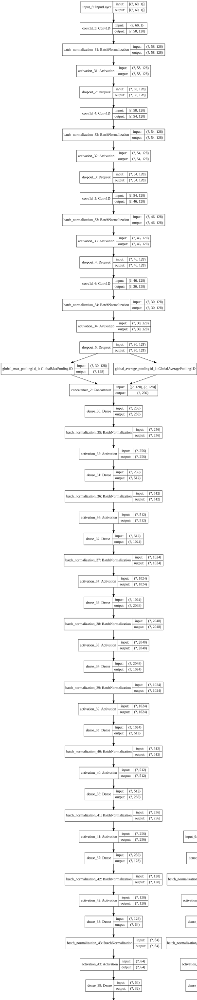

In [16]:
from IPython.display import SVG
from tensorflow.python.keras.utils.vis_utils import model_to_dot
SVG(model_to_dot(model,show_shapes = True).create(prog='dot', format='svg'))

Train the model with early stopping

In [17]:
from datetime import datetime
import os

from tensorflow.keras.callbacks import Callback
import matplotlib.pyplot as plt
import numpy as np
from scikitplot.metrics import plot_confusion_matrix, plot_roc


class PerformanceVisualizationCallback(Callback):
    def __init__(self, model, validation_data, image_dir):
        super().__init__()
        self.model = model
        self.validation_data = validation_data
        
        os.makedirs(image_dir, exist_ok=True)
        self.image_dir = image_dir

    def on_epoch_end(self, epoch, logs={}):
        y_pred = np.asarray(self.model.predict(self.validation_data[0]))
        y_true = self.validation_data[1]             
        y_pred_class = np.argmax(y_pred, axis=1)

        # plot and save confusion matrix
        fig, ax = plt.subplots(figsize=(16,12))
        chart = plot_confusion_matrix(y_true, y_pred_class, ax=ax)
        fig.savefig(os.path.join(self.image_dir, f'confusion_matrix_epoch_{epoch}'))
        plt.display(chart)
        plt.show()
        
       # plot and save roc curve
        fig, ax = plt.subplots(figsize=(16,12))
        plot_roc(y_true, y_pred, ax=ax)
        chart = fig.savefig(os.path.join(self.image_dir, f'roc_curve_epoch_{epoch}'))
        plt.display(chart)
        plt.show()

timestamp = datetime.now().strftime("%Y%m%d-%H%M%S") 
logdir = "logs\\scalars\\" + timestamp

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir)
model_path = "C:\\save_model\\" + xfileName + timestamp
checkpoint_val_loss = ModelCheckpoint(model_path + "_" + ".val_loss.{val_loss:.2f}", monitor='val_loss', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_0 = ModelCheckpoint(model_path + "_" + ".val_Precision_0.{val_Precision_0:.2f}", monitor='val_loss', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_0_075 = ModelCheckpoint(model_path + "_" + ".val_Precision_0_075.{val_Precision_0_075:.2f}", monitor='val_Precision_0_075', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_0_080 = ModelCheckpoint(model_path + "_" + ".val_Precision_0_080.{val_Precision_0_080:.2f}", monitor='val_Precision_0_080', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_0_085 = ModelCheckpoint(model_path + "_" + ".val_Precision_0_085.{val_Precision_0_085:.2f}", monitor='val_Precision_0_085', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_0_090 = ModelCheckpoint(model_path + "_" + ".val_Precision_0_090.{val_Precision_0_090:.2f}", monitor='val_Precision_0_090', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_2 = ModelCheckpoint(model_path +"_"  + ".val_Precision_2.{val_Precision_2:.2f}", monitor='val_Precision_2', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_2_075 = ModelCheckpoint(model_path + "_" + ".val_Precision_2_075.{val_Precision_2_075:.2f}", monitor='val_Precision_2_075', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_2_080 = ModelCheckpoint(model_path + "_" + ".val_Precision_2_080.{val_Precision_2_080:.2f}", monitor='val_Precision_2_080', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_2_085 = ModelCheckpoint(model_path + "_" + ".val_Precision_2_085.{val_Precision_2_085:.2f}", monitor='val_Precision_2_085', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
checkpoint_val_Precision_2_090 = ModelCheckpoint(model_path + "_" + ".val_Precision_2_090.{val_Precision_2_090:.2f}", monitor='val_Precision_2_090', verbose=1, 
                             save_best_only=True, mode='max', save_weights_only = False)
 


reduceLROnPlat = ReduceLROnPlateau(monitor='val_loss', factor=0.8, patience=10, verbose=1, mode='auto', min_delta=0.0001, cooldown=5, min_lr=0.001)
early = EarlyStopping(monitor="val_loss", 
                      mode="min", 
                      patience=100) 
performance_cbk = PerformanceVisualizationCallback(
                      model=model,
                      validation_data=v_dataset,
                      image_dir='performance_vizualizations')

callbacks_list = [checkpoint_val_loss,
                  checkpoint_val_Precision_0,
                  checkpoint_val_Precision_0_075,
                  checkpoint_val_Precision_0_080,
                  checkpoint_val_Precision_0_085,
                  checkpoint_val_Precision_0_090,                  
                  checkpoint_val_Precision_2,
                  checkpoint_val_Precision_2_075,
                  checkpoint_val_Precision_2_080,
                  checkpoint_val_Precision_2_085,
                  checkpoint_val_Precision_2_090,
#                  early,
                   reduceLROnPlat
#                  , tensorboard_callback
                  
                 ]


from IPython.display import clear_output
model.fit(train_dataset_x,
                      validation_data = v_dataset, 
#                       batch_size = 10,
                      epochs = 3000,
                      use_multiprocessing = True,
#                       callbacks = callbacks_list
         )

# model.fit([train_X, train_X2], [train_y, train_y],
#                       validation_data = ([valid_X, valid_X2], [valid_y, valid_y]), 
#                       batch_size = batch_size,
#                       epochs = 500,
#                       callbacks = callbacks_list)

#clear_output()

W1111 00:27:35.607081 10092 network.py:957] Model was constructed with shape (None, 60, 1) for input Tensor("input_5:0", shape=(None, 60, 1), dtype=float32), but it was called on an input with incompatible shape (1, 1, 1).
W1111 00:27:35.609083 10092 network.py:957] Model was constructed with shape (None, 4) for input Tensor("input_6:0", shape=(None, 4), dtype=float32), but it was called on an input with incompatible shape (4, 1).


Epoch 1/3000


ValueError: in user code:

    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\training.py:571 train_function  *
        outputs = self.distribute_strategy.run(
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\distribute\distribute_lib.py:951 run  **
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\distribute\distribute_lib.py:2290 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\distribute\distribute_lib.py:2649 _call_for_each_replica
        return fn(*args, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\training.py:531 train_step  **
        y_pred = self(x, training=True)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\base_layer.py:927 __call__
        outputs = call_fn(cast_inputs, *args, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\network.py:719 call
        convert_kwargs_to_constants=base_layer_utils.call_context().saving)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\network.py:888 _run_internal_graph
        output_tensors = layer(computed_tensors, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\engine\base_layer.py:927 __call__
        outputs = call_fn(cast_inputs, *args, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\keras\layers\convolutional.py:207 call
        outputs = self._convolution_op(inputs, self.kernel)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\nn_ops.py:1106 __call__
        return self.conv_op(inp, filter)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\nn_ops.py:638 __call__
        return self.call(inp, filter)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\nn_ops.py:237 __call__
        name=self.name)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\nn_ops.py:226 _conv1d
        name=name)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\util\deprecation.py:574 new_func
        return func(*args, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\util\deprecation.py:574 new_func
        return func(*args, **kwargs)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\nn_ops.py:1663 conv1d
        name=name)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\ops\gen_nn_ops.py:969 conv2d
        data_format=data_format, dilations=dilations, name=name)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\framework\op_def_library.py:744 _apply_op_helper
        attrs=attr_protos, op_def=op_def)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\framework\func_graph.py:595 _create_op_internal
        compute_device)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\framework\ops.py:3327 _create_op_internal
        op_def=op_def)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\framework\ops.py:1817 __init__
        control_input_ops, op_def)
    C:\Users\Admin\Anaconda3\envs\Transformer_1D-CNN_Feature_Extraction_tf2.2\lib\site-packages\tensorflow\python\framework\ops.py:1657 _create_c_op
        raise ValueError(str(e))

    ValueError: Negative dimension size caused by subtracting 3 from 1 for '{{node model_2/conv1d_3/conv1d}} = Conv2D[T=DT_FLOAT, data_format="NHWC", dilations=[1, 1, 1, 1], explicit_paddings=[], padding="VALID", strides=[1, 1, 1, 1], use_cudnn_on_gpu=true](model_2/conv1d_3/conv1d/ExpandDims, model_2/conv1d_3/conv1d/ExpandDims_1)' with input shapes: [1,1,1,1], [1,3,1,128].


In [18]:
# model.fit(train_dataset,
#                       validation_data = v_dataset, 
# #                       batch_size = 10,
#                       epochs = 3000,
#                       use_multiprocessing = True,
#                       callbacks = callbacks_list)

In [ ]:
#model = tf.keras.models.load_model('./xau_usd_cross-360p-high2Tp1Cl100VpConc.0.69.hdf5')

# export_path = './model/1'
# tf.saved_model.save(model, export_path)



In [ ]:
#model.load_weights('xau_usd_cross-360p-high2Tp1Cl100VpConc.0.69.hdf5')
# model.load_weights(weight_path)


lstm_results = model.evaluate(test_dataset, return_dict=True)
print(lstm_results)

In [ ]:
print(lstm_results)


In [ ]:
model.save_weights('./trained_model.h5', overwrite=True)

Load and normalize the test data

In [ ]:
def load_test(ts_length = 150000):
    base_dir = 'input/test/'
    test_files = [f for f in listdir(base_dir) if isfile(join(base_dir, f))]

    ts = np.empty([len(test_files), ts_length])
    ids = []
    
    i = 0
    for f in tqdm_notebook(test_files):
        ids.append(splitext(f)[0])
        t_df = pd.read_csv(base_dir + f, dtype={"acoustic_data": np.int8})
        ts[i, :] = t_df['acoustic_data'].values
        i = i + 1

    return ts, ids

In [ ]:
test_data, test_ids = load_test()

In [ ]:
X_test = test_data
X_test = np.expand_dims(X_test, 2)
X_test.shape

Load best model and predict

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
submission_df = pd.DataFrame({'seg_id': test_ids, 'time_to_failure': y_pred[:, 0]})

In [ ]:
submission_df.to_csv("submission.csv", index=False)

<a href="submission.csv"> Download File </a>



In [ ]:
lb.transform([-1, 0, 1])

In [ ]:
import numpy as np
nn = np.array([[1., 0.,2], [2., 1.,3], [0., 0.,4]])
print(nn[1, -1])

In [ ]:
 
print(valid_X)


In [ ]:

print(valid_X2)

In [ ]:
print(train_dataset.take(2))

In [ ]:
model.compile(optimizer=optimizer, 
                          loss='categorical_crossentropy',
                          loss_weights=[1., 1.]
#                           loss_weights=[1.]
#               
                            , metrics=[Recall(thresholds=0.5, class_id=0, top_k=1)
                                 , Recall(thresholds=0.5, class_id=2, top_k=1)
                                   , Precision(thresholds=0.5, class_id=0, top_k=1)
                                  , Precision(thresholds=0.5, class_id=2, top_k=1)
                                  ]
             )
model.summary()

In [ ]:
print(tf.__version__)

In [ ]:
from tensorflow.keras.models import Model, load_model
model = load_model('./xau_usd_cross-360p-high2Tp1Cl100VpConc.1.13.hdf5')
model.save('./model/')

In [ ]:
# Load save model pd file back to keras model for evaluate
model2 = tensorflow.keras.models.load_model('C:/save_model/xau_usd_3.0Tp3.0Cl100Vp.txt20231106-164636_.val_Precision_2_090.1.00/')
print(model2.evaluate(test_dataset, return_dict=True))


In [ ]:
# Load save model pd file back to keras model for evaluate
model2 = tensorflow.keras.models.load_model('C:/save_model/xau_usd_3.0Tp3.0Cl100Vp.txt20231105-182526_.val_Precision_2_075.0.67/')
print(model2.evaluate(test_dataset, return_dict=True))


In [ ]:
# Load save model pd file back to keras model for evaluate
model2 = tensorflow.keras.models.load_model('C:/save_model/xau_usd_3.0Tp3.0Cl100Vp.txt20231105-140443_.val_Precision_2_080.0.80/')
lstm_results = model2.evaluate(test_dataset, return_dict=True)
print(lstm_results)

In [ ]:
# Load save model pd file back to keras model for evaluate
model2 = tensorflow.keras.models.load_model('C:/save_model/xau_usd_3.0Tp3.0Cl100Vp.txt20231104-144540_.val_Precision_0_085.0.79/')
lstm_results = model2.evaluate(v_dataset, return_dict=True)
print(lstm_results)

In [ ]:
 
for x in train_dataset_x:
    print(x)

In [ ]:
import tensorflow as tf
string_vals=tf.compat.v1.string_split(['1,2,3'],delimiter=',').values
string_vals = tf.compat.v1.string_to_number(string_vals, tf.float32)
input_tensor = tf.constant(string_vals, dtype=tf.float32)
reshaped_tensor = tf.reshape(input_tensor, shape=(1, -1, 1))
print(reshaped_tensor)